# **Bank Churn Prediction**

## **Objective:**
Given a Bank customer, build a neural network-based classifier that can determine whether they will leave or not in the next 6 months.

### Context: 
Businesses like banks that provide service have to worry about the problem of 'Churn' i.e. customers leaving and joining another service provider. It is important to understand which aspects of the service influence a customer's decision in this regard. Management can concentrate efforts on the improvement of service, keeping in mind these priorities.

### Data Description: 
The case study is from an open-source dataset from Kaggle. The dataset contains 10,000 sample points with 14 distinct features such as CustomerId, CreditScore, Geography, Gender, Age, Tenure, Balance, etc.
Link to the Kaggle project site:https://www.kaggle.com/barelydedicated/bank-customer-churn-modeling

### Data Dictionary:
* RowNumber: Row number.
* CustomerId: Unique identification key for different customers.
* Surname: Surname of the customer
* Credit Score: Credit score is a measure of an individual's ability to pay back the borrowed amount. It is the numerical representation of their creditworthiness. A credit score is a 3-digit number that falls in the range of 300-900, 900 being the highest.
* Geography: The country to which the customer belongs.
* Gender: The gender of the customer.
* Age: Age of the customer.
* Tenure: The period of time a customer has been associated with the bank.
* Balance: The account balance (the amount of money deposited in the bank account) of the customer.
* NumOfProducts: How many accounts, bank account affiliated products the person has.
* HasCrCard: Does the customer have a credit card through the bank?
* IsActiveMember: Subjective, but for the concept
* EstimatedSalary: Estimated salary of the customer.
* Exited: Did they leave the bank after all?

### Points Distribution:
1. Read the dataset
2. Drop the columns which are unique for all users like IDs (5 points)
3. Perform bivariate analysis and give your insights from the same (5 points) 
4. Distinguish the feature and target set and divide the data set into training and test sets (5 points)
5. Normalize the train and test data (10points)
6. Initialize & build the model. Identify the points of improvement and implement the same. (20)
7. Predict the results using 0.5 as a threshold (10points)
8. Print the Accuracy score and confusion matrix (5 points)

#### Import Libraries and Load the data

In [1]:
from google.colab import drive

In [2]:
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [3]:
import warnings
warnings.filterwarnings('ignore')

In [4]:
!pip install shap

In [5]:
!pip install hiplot

In [6]:
!pip install tensorflow==2.3

In [7]:
!pip install keras
!pip install -U keras-tuner

Requirement already up-to-date: keras-tuner in /usr/local/lib/python3.6/dist-packages (1.0.2)


In [8]:
import tensorflow as tf
print(tf.__version__)

2.3.0


In [9]:
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn.model_selection import train_test_split
import tensorflow as tf
from sklearn import preprocessing
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, BatchNormalization
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, recall_score, f1_score, precision_recall_curve, auc
import matplotlib.pyplot as plt
from tensorflow.keras import optimizers

In [10]:
project_path = '/content/drive/My Drive/Colab Notebooks/UT Austin AIML Course/06-04_Project/02_Practice/'

In [11]:
dataset_file = project_path + 'bank.csv'

In [12]:
data = pd.read_csv(dataset_file)

In [13]:
data.head()

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,1,15634602,Hargrave,619,France,Female,42,2,0.00,1,1,1,101348.88,1
1,2,15647311,Hill,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0
2,3,15619304,Onio,502,France,Female,42,8,159660.80,3,1,0,113931.57,1
3,4,15701354,Boni,699,France,Female,39,1,0.00,2,0,0,93826.63,0
4,5,15737888,Mitchell,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0


In [14]:
data.tail()

,RowNumber,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
9995,9996,15606229,Obijiaku,771,France,Male,39,5,0.00,2,1,0,96270.64,0
9996,9997,15569892,Johnstone,516,France,Male,35,10,57369.61,1,1,1,101699.77,0
9997,9998,15584532,Liu,709,France,Female,36,7,0.00,1,0,1,42085.58,1
9998,9999,15682355,Sabbatini,772,Germany,Male,42,3,75075.31,2,1,0,92888.52,1
9999,10000,15628319,Walker,792,France,Female,28,4,130142.79,1,1,0,38190.78,0


In [15]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 14 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   RowNumber        10000 non-null  int64  
 1   CustomerId       10000 non-null  int64  
 2   Surname          10000 non-null  object 
 3   CreditScore      10000 non-null  int64  
 4   Geography        10000 non-null  object 
 5   Gender           10000 non-null  object 
 6   Age              10000 non-null  int64  
 7   Tenure           10000 non-null  int64  
 8   Balance          10000 non-null  float64
 9   NumOfProducts    10000 non-null  int64  
 10  HasCrCard        10000 non-null  int64  
 11  IsActiveMember   10000 non-null  int64  
 12  EstimatedSalary  10000 non-null  float64
 13  Exited           10000 non-null  int64  
dtypes: float64(2), int64(9), object(3)
memory usage: 1.1+ MB


In [16]:
data.shape

(10000, 14)

In [17]:
# Drop the columns which are unique for all users like IDs
data = data.drop(["RowNumber", "CustomerId", "Surname"], axis=1)

In [18]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 11 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   CreditScore      10000 non-null  int64  
 1   Geography        10000 non-null  object 
 2   Gender           10000 non-null  object 
 3   Age              10000 non-null  int64  
 4   Tenure           10000 non-null  int64  
 5   Balance          10000 non-null  float64
 6   NumOfProducts    10000 non-null  int64  
 7   HasCrCard        10000 non-null  int64  
 8   IsActiveMember   10000 non-null  int64  
 9   EstimatedSalary  10000 non-null  float64
 10  Exited           10000 non-null  int64  
dtypes: float64(2), int64(7), object(2)
memory usage: 859.5+ KB


In [19]:
data.isna().any()

CreditScore        False
Geography          False
Gender             False
Age                False
Tenure             False
Balance            False
NumOfProducts      False
HasCrCard          False
IsActiveMember     False
EstimatedSalary    False
Exited             False
dtype: bool

In [20]:
data.duplicated().any()

False

##### Note:
No duplicated records.

In [21]:
# User One hot encoding to convert categorical variables ("Geography and Gender") into numerical variables.
data = pd.get_dummies(data, drop_first=True)

In [22]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 12 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   CreditScore        10000 non-null  int64  
 1   Age                10000 non-null  int64  
 2   Tenure             10000 non-null  int64  
 3   Balance            10000 non-null  float64
 4   NumOfProducts      10000 non-null  int64  
 5   HasCrCard          10000 non-null  int64  
 6   IsActiveMember     10000 non-null  int64  
 7   EstimatedSalary    10000 non-null  float64
 8   Exited             10000 non-null  int64  
 9   Geography_Germany  10000 non-null  uint8  
 10  Geography_Spain    10000 non-null  uint8  
 11  Gender_Male        10000 non-null  uint8  
dtypes: float64(2), int64(7), uint8(3)
memory usage: 732.5 KB


In [23]:
data.head()

,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited,Geography_Germany,Geography_Spain,Gender_Male
0,619,42,2,0.00,1,1,1,101348.88,1,0,0,0
1,608,41,1,83807.86,1,0,1,112542.58,0,0,1,0
2,502,42,8,159660.80,3,1,0,113931.57,1,0,0,0
3,699,39,1,0.00,2,0,0,93826.63,0,0,0,0
4,850,43,2,125510.82,1,1,1,79084.10,0,0,1,0


In [24]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
CreditScore,10000.0,650.528800,96.653299,350.00,584.00,652.000,718.0000,850.00
Age,10000.0,38.921800,10.487806,18.00,32.00,37.000,44.0000,92.00
Tenure,10000.0,5.012800,2.892174,0.00,3.00,5.000,7.0000,10.00
Balance,10000.0,76485.889288,62397.405202,0.00,0.00,97198.540,127644.2400,250898.09
NumOfProducts,10000.0,1.530200,0.581654,1.00,1.00,1.000,2.0000,4.00
HasCrCard,10000.0,0.705500,0.455840,0.00,0.00,1.000,1.0000,1.00
IsActiveMember,10000.0,0.515100,0.499797,0.00,0.00,1.000,1.0000,1.00
EstimatedSalary,10000.0,100090.239881,57510.492818,11.58,51002.11,100193.915,149388.2475,199992.48
Exited,10000.0,0.203700,0.402769,0.00,0.00,0.000,0.0000,1.00
Geography_Germany,10000.0,0.250900,0.433553,0.00,0.00,0.000,1.0000,1.00


In [25]:
data.skew().sort_values(ascending=False)

Exited               1.471611
Geography_Spain      1.169106
Geography_Germany    1.149340
Age                  1.011320
NumOfProducts        0.745568
Tenure               0.010991
EstimatedSalary      0.002085
IsActiveMember      -0.060437
CreditScore         -0.071607
Balance             -0.141109
Gender_Male         -0.183596
HasCrCard           -0.901812
dtype: float64

In [26]:
data.kurt().sort_values(ascending=False)

Age                  1.395347
NumOfProducts        0.582981
Exited               0.165671
CreditScore         -0.425726
Geography_Spain     -0.633318
Geography_Germany   -0.679153
Tenure              -1.165225
EstimatedSalary     -1.181518
HasCrCard           -1.186973
Balance             -1.489412
Gender_Male         -1.966686
IsActiveMember      -1.996747
dtype: float64

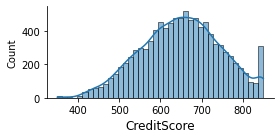

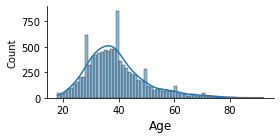

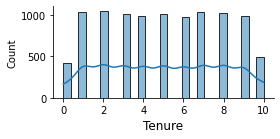

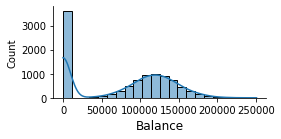

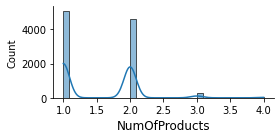

...

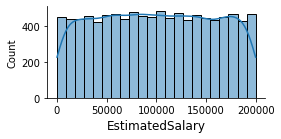

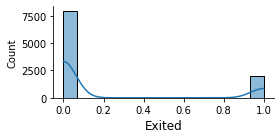

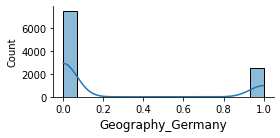

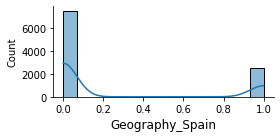

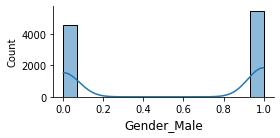

In [27]:
for col in data.columns:
  sns.displot(data[col], kde=True, height=2, aspect=2)
  plt.xlabel(col, fontsize=12)
  plt.ylabel("Count", fontsize=10)
  plt.show()

##### Insights:
There are outliers in Credit Score and Balance.

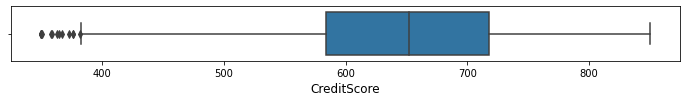

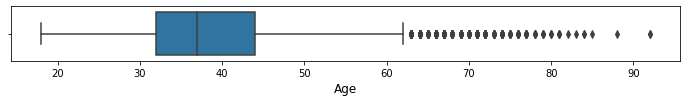

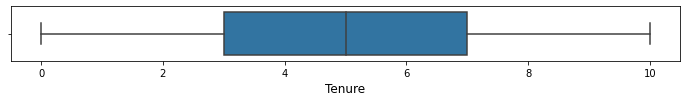

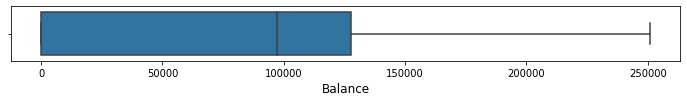

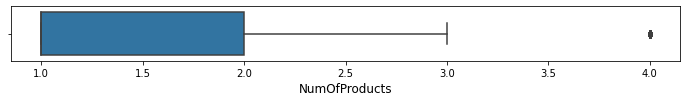

...

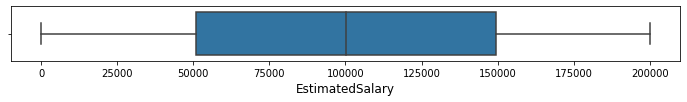

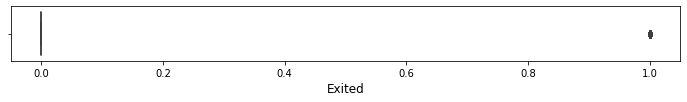

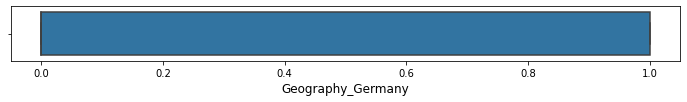

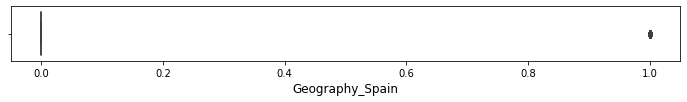

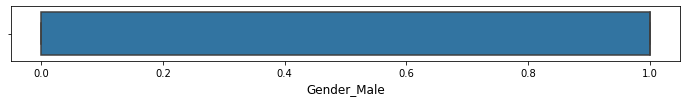

In [28]:
for i in data.columns:
  plt.figure(figsize=(12,1))
  sns.boxplot(x=i, data=data)
  plt.xlabel(i, fontsize=12)
  plt.show()
  print()

##### Insights:
There are outliers in CreditScore and Age.

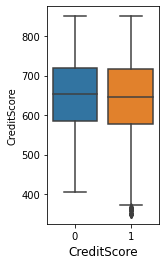

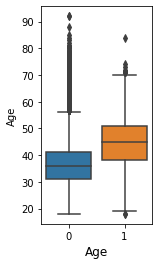

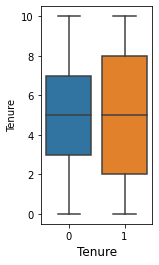

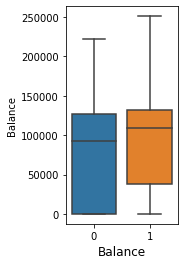

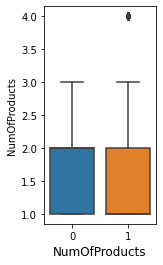

...

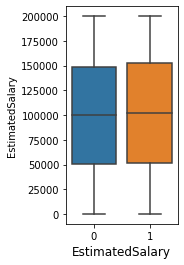

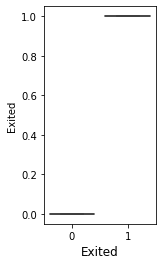

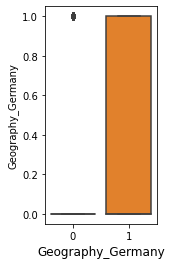

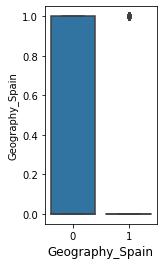

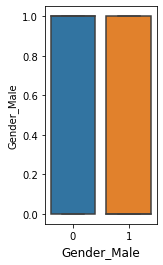

In [29]:
for i in data.columns:
  plt.figure(figsize=(2,4))
  sns.boxplot(x="Exited", y=i , data=data)
  plt.xlabel(i, fontsize=12)
  plt.show()
  print()

In [30]:
# Check distributions for Exited 0 vs 1
exited_0 = data[data["Exited"]==0]
exited_1 = data[data["Exited"]==1]

In [31]:
exited_0.describe().T

,count,mean,std,min,25%,50%,75%,max
CreditScore,7963.0,651.853196,95.653837,405.00,585.00,653.00,718.000,850.00
Age,7963.0,37.408389,10.125363,18.00,31.00,36.00,41.000,92.00
Tenure,7963.0,5.033279,2.880658,0.00,3.00,5.00,7.000,10.00
Balance,7963.0,72745.296779,62848.040701,0.00,0.00,92072.68,126410.280,221532.80
NumOfProducts,7963.0,1.544267,0.509536,1.00,1.00,2.00,2.000,3.00
HasCrCard,7963.0,0.707146,0.455101,0.00,0.00,1.00,1.000,1.00
IsActiveMember,7963.0,0.554565,0.497045,0.00,0.00,1.00,1.000,1.00
EstimatedSalary,7963.0,99738.391772,57405.586966,90.07,50783.49,99645.04,148609.955,199992.48
Exited,7963.0,0.000000,0.000000,0.00,0.00,0.00,0.000,0.00
Geography_Germany,7963.0,0.212859,0.409355,0.00,0.00,0.00,0.000,1.00


In [32]:
exited_1.describe().T

,count,mean,std,min,25%,50%,75%,max
CreditScore,2037.0,645.351497,100.321503,350.00,578.00,646.00,716.00,850.00
Age,2037.0,44.837997,9.761562,18.00,38.00,45.00,51.00,84.00
Tenure,2037.0,4.932744,2.936106,0.00,2.00,5.00,8.00,10.00
Balance,2037.0,91108.539337,58360.794816,0.00,38340.02,109349.29,131433.33,250898.09
NumOfProducts,2037.0,1.475209,0.801521,1.00,1.00,1.00,2.00,4.00
HasCrCard,2037.0,0.699067,0.458776,0.00,0.00,1.00,1.00,1.00
IsActiveMember,2037.0,0.360825,0.480358,0.00,0.00,0.00,1.00,1.00
EstimatedSalary,2037.0,101465.677531,57912.418071,11.58,51907.72,102460.84,152422.91,199808.10
Exited,2037.0,1.000000,0.000000,1.00,1.00,1.00,1.00,1.00
Geography_Germany,2037.0,0.399607,0.489938,0.00,0.00,0.00,1.00,1.00


##### Insights:
There are large difference in the mean of Balance, IsActiveMember, Geography_German, and Gender_Male<br>
There are large difference in the std of Balance, NumOfProducts, and Geography_Germany

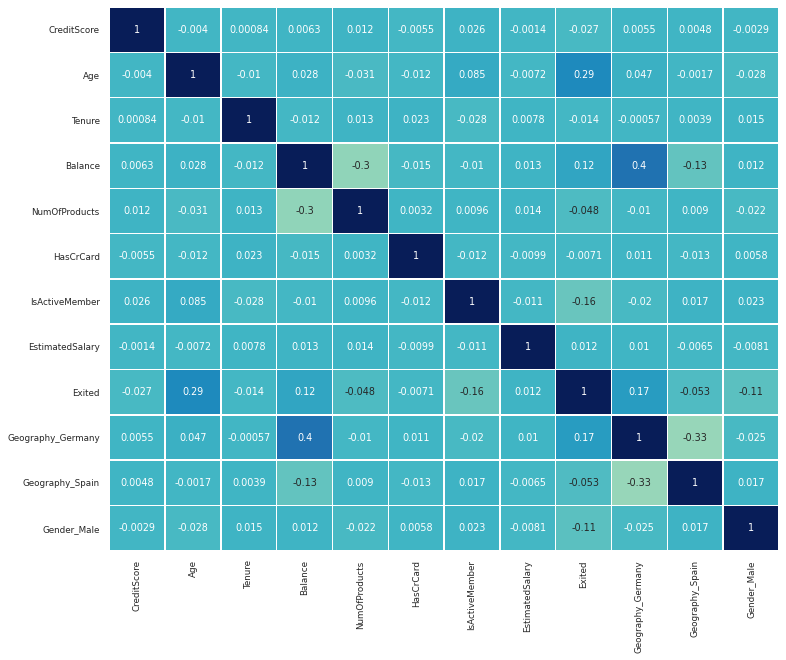

In [33]:
plt.figure(figsize=(12,10))

sns.set(font_scale=0.8)

sns.heatmap(data.corr(),
            annot=True,
            linewidths=.5,
            center=0,
            cbar=False,
            cmap="YlGnBu")

plt.show()

##### Note:
Originally, "Gender" and Geography had high correlation and added "drop_first=True" when running pd.get_dummies().
There are relatively higher correlation in following:
- Exited and Age
- NumOfProducts and Balance
- Geography_Germany and Balance

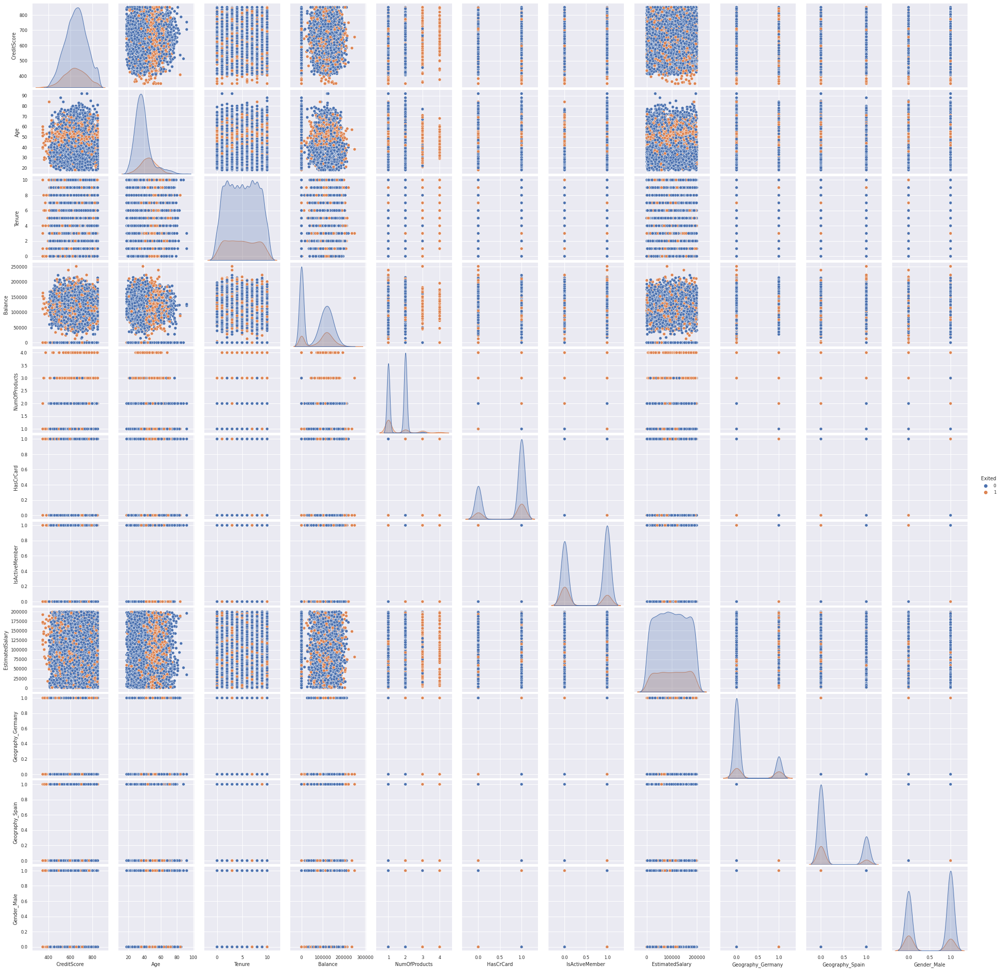

In [34]:
sns.pairplot(data, hue="Exited")

##### Insights:
We can see a slightly different distribution in following:
- Age
- Balance
- NumOfProducts
- IsActiveMember
- Geography_Germany
- Gender_Male

In [35]:
# Distinguish the feature and target sets

X_data = data.drop("Exited", axis=1)
y_data = data["Exited"]

In [36]:
X_data.head()

,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Geography_Germany,Geography_Spain,Gender_Male
0,619,42,2,0.00,1,1,1,101348.88,0,0,0
1,608,41,1,83807.86,1,0,1,112542.58,0,1,0
2,502,42,8,159660.80,3,1,0,113931.57,0,0,0
3,699,39,1,0.00,2,0,0,93826.63,0,0,0
4,850,43,2,125510.82,1,1,1,79084.10,0,1,0


In [37]:
y_data.head()

0    1
1    0
2    1
3    0
4    0
Name: Exited, dtype: int64

In [38]:
X_data.shape

(10000, 11)

In [39]:
y_data.shape

(10000,)

In [40]:
y_data.value_counts()

0    7963
1    2037
Name: Exited, dtype: int64

###### Insights:
0 vs 1 is 80:20 -> Inbalanced data

In [41]:
###############################################################################################################################################################################
#
# Divide the data set into training and test sets 
#
###############################################################################################################################################################################

X_train, X_test, y_train, y_test = train_test_split(X_data, y_data, test_size=0.2, random_state=1)

In [42]:
X_train.head()

,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Geography_Germany,Geography_Spain,Gender_Male
2694,628,29,3,113146.98,2,0,1,124749.08,1,0,1
5140,626,29,4,105767.28,2,0,0,41104.82,0,0,0
2568,612,47,6,130024.87,1,1,1,45750.21,1,0,0
3671,646,52,6,111739.40,2,0,1,68367.18,1,0,0
7427,714,33,8,122017.19,1,0,0,162515.17,0,1,1


In [43]:
X_test.head()

,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Geography_Germany,Geography_Spain,Gender_Male
9953,550,47,2,0.00,2,1,1,97057.28,0,0,1
3850,680,34,3,143292.95,1,1,0,66526.01,0,0,1
4962,531,42,2,0.00,2,0,1,90537.47,0,0,0
3886,710,34,8,147833.30,2,0,1,1561.58,1,0,1
5437,543,30,6,73481.05,1,1,1,176692.65,1,0,1


In [44]:
columns = X_train.columns
print(columns)

Index(['CreditScore', 'Age', 'Tenure', 'Balance', 'NumOfProducts', 'HasCrCard',
       'IsActiveMember', 'EstimatedSalary', 'Geography_Germany',
       'Geography_Spain', 'Gender_Male'],
      dtype='object')


In [45]:
# Normalize the train and test data
# Will use Standard Scaler

scaler = preprocessing.StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [46]:
X_train.shape[1]

11

In [47]:
a = range(0,X_train.shape[1])
for n in a:
  print(n)

0
1
2
3
4
5
6
7
8
9
10


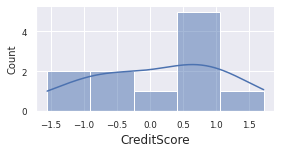

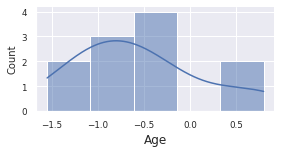

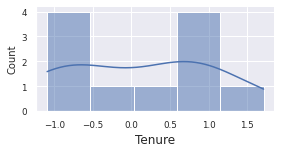

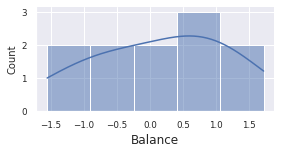

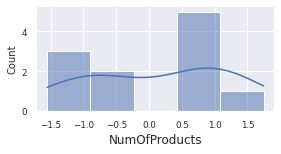

...

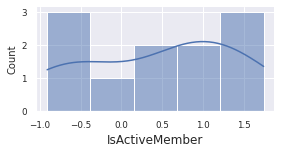

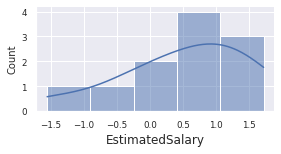

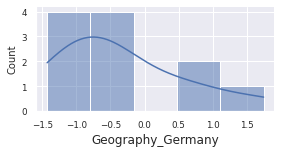

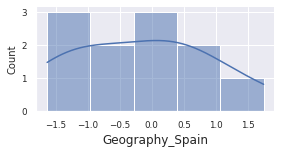

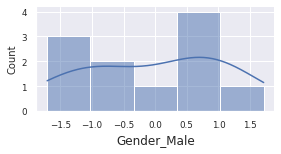

In [48]:
for i in range(X_train.shape[1]):
  sns.displot(X_train[i], kde=True, height=2, aspect=2)
  plt.xlabel(columns[i], fontsize=12)
  plt.ylabel("Count", fontsize=10)
  plt.show()

In [49]:
pd.DataFrame(X_train).describe().T

,count,mean,std,min,25%,50%,75%,max
0,8000.0,-7.341350e-17,1.000063,-3.106555,-0.696317,0.007100,0.700173,2.065630
1,8000.0,-1.413737e-15,1.000063,-1.995297,-0.657919,-0.180283,0.488406,5.073704
2,8000.0,1.076569e-16,1.000063,-1.741360,-0.701742,-0.008663,0.684415,1.724033
3,8000.0,2.817677e-16,1.000063,-1.225992,-1.225992,0.330161,0.820539,2.796832
4,8000.0,-1.125641e-15,1.000063,-0.911510,-0.911510,-0.911510,0.802257,4.229790
5,8000.0,-8.604228e-17,1.000063,-1.553374,-1.553374,0.643760,0.643760,0.643760
6,8000.0,6.718515e-16,1.000063,-1.023271,-1.023271,0.977259,0.977259,0.977259
7,8000.0,-2.015055e-16,1.000063,-1.737875,-0.853352,-0.005336,0.855115,1.733977
8,8000.0,9.625634e-17,1.000063,-0.583124,-0.583124,-0.583124,1.714901,1.714901
9,8000.0,2.493561e-16,1.000063,-0.572731,-0.572731,-0.572731,-0.572731,1.746019


In [50]:
X_train[0]

array([-0.23082038, -0.94449979, -0.70174202,  0.58817274,  0.80225696,
       -1.55337352,  0.97725852,  0.42739449,  1.71490137, -0.57273139,
        0.91509065])

In [51]:
X_test[0]

array([-1.03768121,  0.77498705, -1.0482813 , -1.22599173,  0.80225696,
        0.64376017,  0.97725852, -0.05360571, -0.58312392, -0.57273139,
        0.91509065])

In [52]:
# X_train = preprocessing.normalize(X_train)
# X_test = preprocessing.normalize(X_test)

In [53]:
# for i in range(X_train.shape[1]):
#   sns.displot(X_train[i], kde=True, height=2, aspect=2)
#   plt.xlabel(columns[i], fontsize=12)
#   plt.ylabel("Count", fontsize=10)
#   plt.show()

In [54]:
# pd.DataFrame(X_train).describe().T

In [55]:
print(X_train.shape)
print(X_test.shape)
print(y_train.shape)
print(y_test.shape)

(8000, 11)
(2000, 11)
(8000,)
(2000,)


In [56]:
X_ColNum = X_train.shape[1]

In [57]:
X_ColNum

11

# Models

### Model-1 (First Test)

In [58]:
model_name = "Model-1 (First Test)"
model_layer = "2HL 64_Relu-32_Tanh"
model_optimizer = "Adam-LR_0.001"
model_loss = "binary_crossentropy"

num_epoch = 100
num_batch = 100

#### Creating a model

In [59]:
model = Sequential()

#### Adding layers

In [60]:
model.add(Dense(64, input_shape=(X_ColNum, ), activation='relu'))
model.add(Dense(32, activation='tanh'))
model.add(Dense(1, activation='sigmoid'))

#### Model compile

In [61]:
sgd = optimizers.Adam(lr=0.001)

In [62]:
# Use 0.5 as a threshold

tf.keras.metrics.BinaryAccuracy(
    name='binary_accuracy', dtype=None, threshold=0.5
)

model.compile(optimizer=sgd, loss='binary_crossentropy', metrics=[tf.keras.metrics.BinaryAccuracy()])

#### Summary of the model

In [63]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 64)                768       
_________________________________________________________________
dense_1 (Dense)              (None, 32)                2080      
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 33        
Total params: 2,881
Trainable params: 2,881
Non-trainable params: 0
_________________________________________________________________


#### Training Forward pass and Backpropagation

In [64]:
history = model.fit(X_train, y_train.values, batch_size=num_batch, epochs=num_epoch, verbose=1, validation_split=0.2)

Epoch 1/100
64/64 [==============================] - 0s 4ms/step - loss: 0.4855 - binary_accuracy: 0.7952 - val_loss: 0.4447 - val_binary_accuracy: 0.8087
Epoch 2/100
64/64 [==============================] - 0s 2ms/step - loss: 0.4266 - binary_accuracy: 0.8183 - val_loss: 0.4236 - val_binary_accuracy: 0.8200
Epoch 3/100
64/64 [==============================] - 0s 2ms/step - loss: 0.4103 - binary_accuracy: 0.8230 - val_loss: 0.4087 - val_binary_accuracy: 0.8181
Epoch 4/100
64/64 [==============================] - 0s 2ms/step - loss: 0.3947 - binary_accuracy: 0.8356 - val_loss: 0.3929 - val_binary_accuracy: 0.8313
Epoch 5/100
64/64 [==============================] - 0s 2ms/step - loss: 0.3787 - binary_accuracy: 0.8456 - val_loss: 0.3754 - val_binary_accuracy: 0.8381
Epoch 6/100
64/64 [==============================] - 0s 2ms/step - loss: 0.3670 - binary_accuracy: 0.8511 - val_loss: 0.3679 - val_binary_accuracy: 0.8419
Epoch 7/100
64/64 [==============================] - 0s 2ms/step - los

In [65]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch

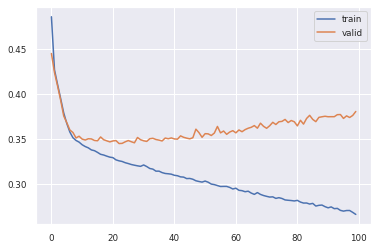

In [66]:
plt.plot(hist['loss'])
plt.plot(hist['val_loss'])
plt.legend(("train", "valid"), loc=0)

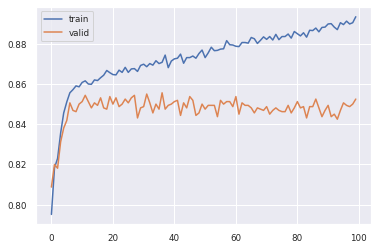

In [67]:
plt.plot(hist['binary_accuracy'])
plt.plot(hist['val_binary_accuracy'])
plt.legend(("train", "valid"), loc=0)

##### Insights:
For the loss, it goes down for both train and valid data at the beginning. Although, the loss for train keep going down, the loss for valid trun going up around epoch 10.<br>
Similary, for the accuracy, it goes up for both train and valid data at the beginning; however, the accuray for valid data truns going down around epoch 10.<br>
Seems like, the number of epoch is too large for this model.

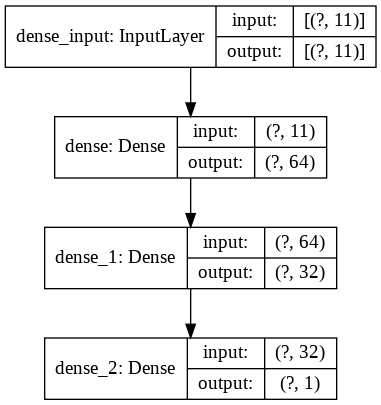

In [68]:
# Show the Model created

from keras.utils.vis_utils import plot_model

plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

#### Evaluation (Loss and Accuracy)

In [69]:
results = model.evaluate(X_test, y_test.values)

63/63 [==============================] - 0s 1ms/step - loss: 0.3620 - binary_accuracy: 0.8555


In [70]:
print(model.metrics_names)
print(results)

['loss', 'binary_accuracy']
[0.36203327775001526, 0.8554999828338623]


#### Confusion Matrix

In [71]:
y_pred_cls = model.predict_classes(X_test, batch_size=100, verbose=0)
print('Accuracy: ' + str(model.evaluate(X_test, y_test.values)[1]))
print('Recall_score: ' + str(recall_score(y_test.values, y_pred_cls)))
print('Precision_score: ' + str(precision_score(y_test.values, y_pred_cls)))
print('F-score: ' + str(f1_score(y_test.values, y_pred_cls)))
confusion_matrix(y_test.values, y_pred_cls)

Instructions for updating:
Please use instead:* `np.argmax(model.predict(x), axis=-1)`,   if your model does multi-class classification   (e.g. if it uses a `softmax` last-layer activation).* `(model.predict(x) > 0.5).astype("int32")`,   if your model does binary classification   (e.g. if it uses a `sigmoid` last-layer activation).
63/63 [==============================] - 0s 1ms/step - loss: 0.3620 - binary_accuracy: 0.8555
Accuracy: 0.8554999828338623
Recall_score: 0.4650602409638554
Precision_score: 0.7423076923076923
F-score: 0.5718518518518518


array([[1518,   67],
       [ 222,  193]])

Instructions for updating:
Simply pass a True/False value to the `training` argument of the `__call__` method of your layer or model.


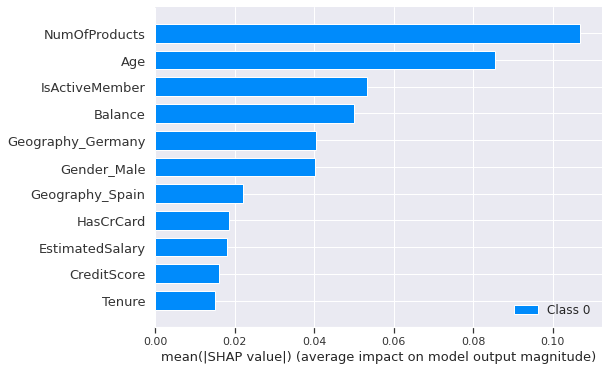

In [72]:
import shap

shap.initjs()
explainer = shap.DeepExplainer(model, X_train[:1000])
shap_values = explainer.shap_values(X_test[:1000])
shap.summary_plot(shap_values, pd.DataFrame(X_test, columns=X_data.columns), plot_type='bar')

##### Insight:
The top 6 functionality have high impact on the model. Will try PCA with 6, later.

#### Comparison:

In [73]:
#Store the accuracy results for each model in a dataframe for final comparison
resultsDf = pd.DataFrame({'Method': [model_name],
                          'Layer and Activation Function': [model_layer],
                          'Optimizer': [model_optimizer],
                          'Loss Func': [model_loss],
                          'Num of Epoc': [num_epoch],
                          'Num of Batch': [num_batch],
                          'Loss': [model.evaluate(X_test, y_test.values)[0]],
                          'Testing accuracy': [model.evaluate(X_test, y_test.values)[1]],
                          'Recall Score': [recall_score(y_test.values, y_pred_cls)],
                          'Precision Score': [precision_score(y_test.values, y_pred_cls)],
                          'F1 Score': [f1_score(y_test.values, y_pred_cls)],
                         })
resultsDf = resultsDf[['Method', 'Layer and Activation Function', 'Optimizer', 'Loss Func', 'Num of Epoc','Num of Batch','Loss', 'Testing accuracy', 'Recall Score', 'Precision Score', 'F1 Score']]
resultsDf

63/63 [==============================] - 0s 1ms/step - loss: 0.3620 - binary_accuracy: 0.8555


,Method,Layer and Activation Function,Optimizer,Loss Func,Num of Epoc,Num of Batch,Loss,Testing accuracy,Recall Score,Precision Score,F1 Score
0,Model-1 (First Test),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,100,100,0.362033,0.8555,0.46506,0.742308,0.571852


### Model-2 (Less number of Epocs)

#### Note
Try 10 Epoc

In [74]:
model_name = "Model-2 (Less number of Epocs)"
model_layer = "2HL 64_Relu-32_Tanh"
model_optimizer = "Adam-LR_0.001"
model_loss = "binary_crossentropy"

num_epoch = 10
num_batch = 100

In [75]:
model = Sequential()

model.add(Dense(64, input_shape=(X_ColNum, ), activation='relu'))
model.add(Dense(32, activation='tanh'))
model.add(Dense(1, activation='sigmoid'))

sgd = optimizers.Adam(lr=0.001)

# Use 0.5 as a threshold

tf.keras.metrics.BinaryAccuracy(
    name='binary_accuracy', dtype=None, threshold=0.5
)

model.compile(optimizer=sgd, loss='binary_crossentropy', metrics=[tf.keras.metrics.BinaryAccuracy()])

model.summary()

history = model.fit(X_train, y_train.values, batch_size=num_batch, epochs=num_epoch, verbose=1, validation_split=0.2)

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_3 (Dense)              (None, 64)                768       
_________________________________________________________________
dense_4 (Dense)              (None, 32)                2080      
_________________________________________________________________
dense_5 (Dense)              (None, 1)                 33        
Total params: 2,881
Trainable params: 2,881
Non-trainable params: 0
_________________________________________________________________
Epoch 1/10
64/64 [==============================] - 0s 4ms/step - loss: 0.4973 - binary_accuracy: 0.7831 - val_loss: 0.4394 - val_binary_accuracy: 0.8106
Epoch 2/10
64/64 [==============================] - 0s 2ms/step - loss: 0.4223 - binary_accuracy: 0.8209 - val_loss: 0.4178 - val_binary_accuracy: 0.8144
Epoch 3/10
64/64 [==============================] - 0s 2ms/step - loss: 0.

In [76]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch

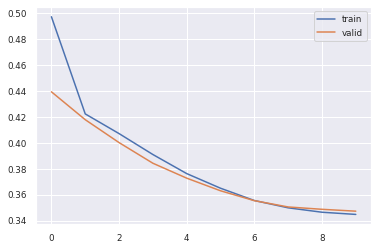

In [77]:
plt.plot(hist['loss'])
plt.plot(hist['val_loss'])
plt.legend(("train", "valid"), loc=0)

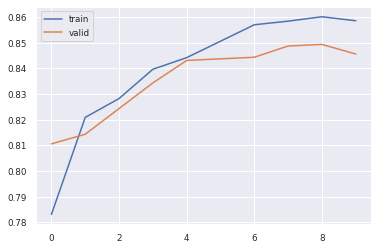

In [78]:
plt.plot(hist['binary_accuracy'])
plt.plot(hist['val_binary_accuracy'])
plt.legend(("train", "valid"), loc=0)

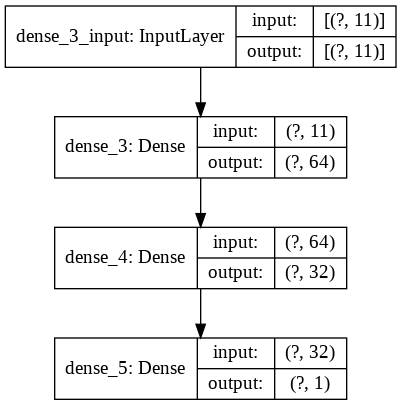

In [79]:
# Show the Model created

from keras.utils.vis_utils import plot_model

plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [80]:
results = model.evaluate(X_test, y_test.values)

63/63 [==============================] - 0s 1ms/step - loss: 0.3473 - binary_accuracy: 0.8555


In [81]:
print(model.metrics_names)
print(results)

['loss', 'binary_accuracy']
[0.34733375906944275, 0.8554999828338623]


In [82]:
y_pred_cls = model.predict_classes(X_test, batch_size=100, verbose=0)
print('Accuracy Model1 (Dropout): ' + str(model.evaluate(X_test, y_test.values)[1]))
print('Recall_score: ' + str(recall_score(y_test.values, y_pred_cls)))
print('Precision_score: ' + str(precision_score(y_test.values, y_pred_cls)))
print('F-score: ' + str(f1_score(y_test.values, y_pred_cls)))
confusion_matrix(y_test.values, y_pred_cls)

63/63 [==============================] - 0s 1ms/step - loss: 0.3473 - binary_accuracy: 0.8555
Accuracy Model1 (Dropout): 0.8554999828338623
Recall_score: 0.4602409638554217
Precision_score: 0.74609375
F-score: 0.5692995529061102


array([[1520,   65],
       [ 224,  191]])

In [83]:
# How loss moves around with each epoch

import hiplot as hip

data_vis = [{'epoch': idx,
             'loss': history.history['loss'][idx],
             'val_loss': history.history['val_loss'][idx],
             'binary_accuracy': history.history['binary_accuracy'][idx],
             'val_binary_accuracy': history.history['val_binary_accuracy'][idx],
             } for idx in range(num_epoch)]
hip.Experiment.from_iterable(data_vis).display()

<IPython.core.display.Javascript object>

##### Insight:
Based on the hiplot above, epoch 10 seems to be the best in this case.

#### Comparison:

In [84]:
tempResultsDf = pd.DataFrame({'Method': [model_name],
                          'Layer and Activation Function': [model_layer],
                          'Optimizer': [model_optimizer],
                          'Loss Func': [model_loss],
                          'Num of Epoc': [num_epoch],
                          'Num of Batch': [num_batch],
                          'Loss': [model.evaluate(X_test, y_test.values)[0]],
                          'Testing accuracy': [model.evaluate(X_test, y_test.values)[1]],
                          'Recall Score': [recall_score(y_test.values, y_pred_cls)],
                          'Precision Score': [precision_score(y_test.values, y_pred_cls)],
                          'F1 Score': [f1_score(y_test.values, y_pred_cls)],
                         })
resultsDf = pd.concat([resultsDf, tempResultsDf])
resultsDf = resultsDf[['Method', 'Layer and Activation Function', 'Optimizer', 'Loss Func', 'Num of Epoc','Num of Batch', 'Loss', 'Testing accuracy', 'Recall Score', 'Precision Score', 'F1 Score']]
print()
print()
resultsDf

63/63 [==============================] - 0s 3ms/step - loss: 0.3473 - binary_accuracy: 0.8555




,Method,Layer and Activation Function,Optimizer,Loss Func,Num of Epoc,Num of Batch,Loss,Testing accuracy,Recall Score,Precision Score,F1 Score
0,Model-1 (First Test),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,100,100,0.362033,0.8555,0.465060,0.742308,0.571852
0,Model-2 (Less number of Epocs),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,10,100,0.347334,0.8555,0.460241,0.746094,0.569300


##### Insight:
Smaller number of epocs improved both Loss and Accuracy

### Model-3 (Mid number of Epocs & Larger Batch)

#### Note
Try 100 Epoc & 1000 Batch & Smaller Learning rate


In [85]:
model_name = "Model-3 (Mid number of Epocs & Larger Batch)"
model_layer = "2HL 64_Relu-32_Tanh"
model_optimizer = "Adam-LR_0.0001"
model_loss = "binary_crossentropy"

num_epoch = 1000
num_batch = 2000

In [86]:
model = Sequential()

model.add(Dense(64, input_shape=(X_ColNum, ), activation='relu'))
model.add(Dense(32, activation='tanh'))
model.add(Dense(1, activation='sigmoid'))

sgd = optimizers.Adam(lr=0.0001)

# Use 0.5 as a threshold

tf.keras.metrics.BinaryAccuracy(
    name='binary_accuracy', dtype=None, threshold=0.5
)

model.compile(optimizer=sgd, loss='binary_crossentropy', metrics=[tf.keras.metrics.BinaryAccuracy()])

model.summary()

history = model.fit(X_train, y_train.values, batch_size=num_batch, epochs=num_epoch, verbose=1, validation_split=0.2)

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_6 (Dense)              (None, 64)                768       
_________________________________________________________________
dense_7 (Dense)              (None, 32)                2080      
_________________________________________________________________
dense_8 (Dense)              (None, 1)                 33        
Total params: 2,881
Trainable params: 2,881
Non-trainable params: 0
_________________________________________________________________
Epoch 1/1000
4/4 [==============================] - 0s 37ms/step - loss: 0.6180 - binary_accuracy: 0.6530 - val_loss: 0.6216 - val_binary_accuracy: 0.6519
Epoch 2/1000
4/4 [==============================] - 0s 8ms/step - loss: 0.6104 - binary_accuracy: 0.6658 - val_loss: 0.6142 - val_binary_accuracy: 0.6669
Epoch 3/1000
4/4 [==============================] - 0s 8ms/step - loss: 0

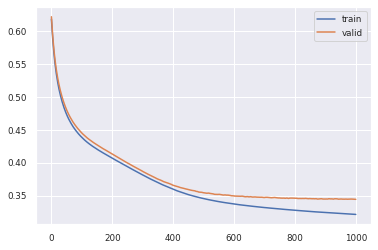

In [87]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch

plt.plot(hist['loss'])
plt.plot(hist['val_loss'])
plt.legend(("train", "valid"), loc=0)

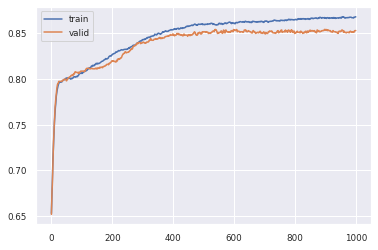

In [88]:
plt.plot(hist['binary_accuracy'])
plt.plot(hist['val_binary_accuracy'])
plt.legend(("train", "valid"), loc=0)

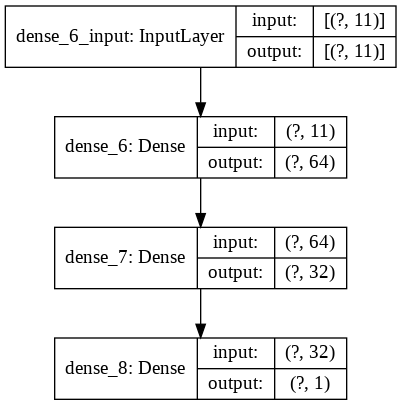

In [89]:
# Show the Model created

from keras.utils.vis_utils import plot_model

plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [90]:
results = model.evaluate(X_test, y_test.values)

63/63 [==============================] - 0s 937us/step - loss: 0.3360 - binary_accuracy: 0.8590


In [91]:
print(model.metrics_names)
print(results)

['loss', 'binary_accuracy']
[0.33600232005119324, 0.859000027179718]


In [92]:
y_pred_cls = model.predict_classes(X_test, batch_size=100, verbose=0)
print('Accuracy Model1 (Dropout): ' + str(model.evaluate(X_test, y_test.values)[1]))
print('Recall_score: ' + str(recall_score(y_test.values, y_pred_cls)))
print('Precision_score: ' + str(precision_score(y_test.values, y_pred_cls)))
print('F-score: ' + str(f1_score(y_test.values, y_pred_cls)))
confusion_matrix(y_test.values, y_pred_cls)

63/63 [==============================] - 0s 1ms/step - loss: 0.3360 - binary_accuracy: 0.8590
Accuracy Model1 (Dropout): 0.859000027179718
Recall_score: 0.4602409638554217
Precision_score: 0.7670682730923695
F-score: 0.5753012048192772


array([[1527,   58],
       [ 224,  191]])

In [93]:
# How loss moves around with each epoch

import hiplot as hip

data_vis = [{'epoch': idx,
             'loss': history.history['loss'][idx],
             'val_loss': history.history['val_loss'][idx],
             'binary_accuracy': history.history['binary_accuracy'][idx],
             'val_binary_accuracy': history.history['val_binary_accuracy'][idx],
             } for idx in range(num_epoch)]
hip.Experiment.from_iterable(data_vis).display()

<IPython.core.display.Javascript object>

##### Insight:
Based on the hiplot above, epoch 940 seems to be the best in this case.

#### Comparison:

In [94]:
tempResultsDf = pd.DataFrame({'Method': [model_name],
                          'Layer and Activation Function': [model_layer],
                          'Optimizer': [model_optimizer],
                          'Loss Func': [model_loss],
                          'Num of Epoc': [num_epoch],
                          'Num of Batch': [num_batch],
                          'Loss': [model.evaluate(X_test, y_test.values)[0]],
                          'Testing accuracy': [model.evaluate(X_test, y_test.values)[1]],
                          'Recall Score': [recall_score(y_test.values, y_pred_cls)],
                          'Precision Score': [precision_score(y_test.values, y_pred_cls)],
                          'F1 Score': [f1_score(y_test.values, y_pred_cls)],
                         })
resultsDf = pd.concat([resultsDf, tempResultsDf])
resultsDf = resultsDf[['Method', 'Layer and Activation Function', 'Optimizer', 'Loss Func', 'Num of Epoc','Num of Batch', 'Loss', 'Testing accuracy', 'Recall Score', 'Precision Score', 'F1 Score']]
print()
print()
resultsDf

63/63 [==============================] - 0s 1ms/step - loss: 0.3360 - binary_accuracy: 0.8590




,Method,Layer and Activation Function,Optimizer,Loss Func,Num of Epoc,Num of Batch,Loss,Testing accuracy,Recall Score,Precision Score,F1 Score
0,Model-1 (First Test),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,100,100,0.362033,0.8555,0.465060,0.742308,0.571852
0,Model-2 (Less number of Epocs),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,10,100,0.347334,0.8555,0.460241,0.746094,0.569300
0,Model-3 (Mid number of Epocs & Larger Batch),2HL 64_Relu-32_Tanh,Adam-LR_0.0001,binary_crossentropy,1000,2000,0.336002,0.8590,0.460241,0.767068,0.575301


##### Insight:
If the learning rate is small, larger number of epocs works better for both loss and accuracy.

## Hyper Parameter Tuning

In [95]:
def build_model(hp):
  model_1 = Sequential() # Start model
  model_1.add(Dense(units=hp.Int('units_in', min_value=16, max_value=256, step=32),
                    input_shape=(X_ColNum, ),
                    activation = hp.Choice('act_in', ['relu', 'tanh']))) # Hidden Layer connected to Input Layer
  for i in range(hp.Int('num_layers', 0, 2)):
    model_1.add(Dense(units=hp.Int('units_' + str(i),
                                   min_value=32,
                                   max_value=512,
                                   step=32),
                      activation=hp.Choice('act_' + str(i), ['relu', 'tanh']))) # Hidden Layer
    model_1.add(Dropout(hp.Float('dropout', 0, 0.5, step=0.1, default=0.3))) # Drop out layer for regularization
  
  model_1.add(Dense(1, activation='sigmoid')) # Output Layer

  model_1.compile(
      optimizer=optimizers.Adam(
          hp.Choice('learning_rate', [1e-2, 1e-3, 1e-4])),
          loss='binary_crossentropy',
          metrics=['accuracy'])
  return model_1

In [96]:
from kerastuner.tuners import RandomSearch

tuner = RandomSearch(
    build_model,
    objective='val_accuracy',
    max_trials=5,
    executions_per_trial=2
)

INFO:tensorflow:Reloading Oracle from existing project ./untitled_project/oracle.json
INFO:tensorflow:Reloading Tuner from ./untitled_project/tuner0.json


In [97]:
tuner.search_space_summary()

Search space summary
Default search space size: 9
units_in (Int)
{'default': None, 'conditions': [], 'min_value': 16, 'max_value': 256, 'step': 32, 'sampling': None}
act_in (Choice)
{'default': 'relu', 'conditions': [], 'values': ['relu', 'tanh'], 'ordered': False}
num_layers (Int)
{'default': None, 'conditions': [], 'min_value': 0, 'max_value': 2, 'step': 1, 'sampling': None}
learning_rate (Choice)
{'default': 0.01, 'conditions': [], 'values': [0.01, 0.001, 0.0001], 'ordered': True}
units_0 (Int)
{'default': None, 'conditions': [], 'min_value': 32, 'max_value': 512, 'step': 32, 'sampling': None}
act_0 (Choice)
{'default': 'relu', 'conditions': [], 'values': ['relu', 'tanh'], 'ordered': False}
dropout (Float)
{'default': 0.3, 'conditions': [], 'min_value': 0.0, 'max_value': 0.5, 'step': 0.1, 'sampling': None}
units_1 (Int)
{'default': None, 'conditions': [], 'min_value': 32, 'max_value': 512, 'step': 32, 'sampling': None}
act_1 (Choice)
{'default': 'relu', 'conditions': [], 'values': [

In [98]:
tuner.search(X_train, y_train.values, epochs=5, validation_split=0.1)

INFO:tensorflow:Oracle triggered exit


In [99]:
# Summary of the best results
print(tuner.results_summary())

Results summary
Results in ./untitled_project
Showing 10 best trials
Objective(name='val_accuracy', direction='max')
Trial summary
Hyperparameters:
units_in: 48
act_in: tanh
num_layers: 2
learning_rate: 0.001
units_0: 352
act_0: tanh
dropout: 0.0
units_1: 32
act_1: relu
Score: 0.8456250131130219
Trial summary
Hyperparameters:
units_in: 208
act_in: tanh
num_layers: 1
learning_rate: 0.001
units_0: 96
act_0: tanh
dropout: 0.4
units_1: 256
act_1: relu
Score: 0.8368749916553497
Trial summary
Hyperparameters:
units_in: 80
act_in: tanh
num_layers: 1
learning_rate: 0.0001
units_0: 480
act_0: relu
dropout: 0.5
units_1: 288
act_1: relu
Score: 0.8237500190734863
Trial summary
Hyperparameters:
units_in: 240
act_in: tanh
num_layers: 1
learning_rate: 0.0001
units_0: 416
act_0: tanh
dropout: 0.2
units_1: 224
act_1: tanh
Score: 0.8024999797344208
Trial summary
Hyperparameters:
units_in: 48
act_in: relu
num_layers: 1
learning_rate: 0.0001
units_0: 32
act_0: relu
dropout: 0.3
Score: 0.7881250083446503
N

In [100]:
# Best Hyperparameter model using Randomized Search CV - This can change on individual machines
print(tuner.get_best_hyperparameters()[0].values)

{'units_in': 48, 'act_in': 'tanh', 'num_layers': 2, 'learning_rate': 0.001, 'units_0': 352, 'act_0': 'tanh', 'dropout': 0.0, 'units_1': 32, 'act_1': 'relu'}


In [101]:
print(tuner.get_best_models()[0].summary())

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 48)                576       
_________________________________________________________________
dense_1 (Dense)              (None, 352)               17248     
_________________________________________________________________
dropout (Dropout)            (None, 352)               0         
_________________________________________________________________
dense_2 (Dense)              (None, 32)                11296     
_________________________________________________________________
dropout_1 (Dropout)          (None, 32)                0         
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 33        
Total params: 29,153
Trainable params: 29,153
Non-trainable params: 0
____________________________________________________

In [102]:
# Run test data against best Hyperparametrized Model
best_model = tuner.get_best_models(num_models=1)[0]
results = best_model.evaluate(X_test, y_test.values)

63/63 [==============================] - 0s 1ms/step - loss: 0.3455 - accuracy: 0.8565


### Model-4 (Using the results from Hyperparameter Tuning)

#### Note
Try 100 Epoc & 1000 Batch

In [103]:
model_name = "Model-4 (Using the results from Hyperparameter Tuning)"
model_layer = "4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_Dropout"
model_optimizer = "Adam-LR_0.001"
model_loss = "binary_crossentropy"

num_epoch = 100
num_batch = 1000

In [104]:
model = Sequential()

model.add(Dense(240, input_shape=(X_ColNum, ), activation='tanh'))
model.add(Dense(512, activation='relu'))
model.add(Dropout(0.0))
model.add(Dense(32, activation='relu'))
model.add(Dropout(0.0))
model.add(Dense(1, activation='sigmoid'))

sgd = optimizers.Adam(lr=0.001)

# Use 0.5 as a threshold

tf.keras.metrics.BinaryAccuracy(
    name='binary_accuracy', dtype=None, threshold=0.5
)

model.compile(optimizer=sgd, loss='binary_crossentropy', metrics=[tf.keras.metrics.BinaryAccuracy()])

model.summary()

history = model.fit(X_train, y_train.values, batch_size=num_batch, epochs=num_epoch, verbose=1, validation_split=0.2)

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_4 (Dense)              (None, 240)               2880      
_________________________________________________________________
dense_5 (Dense)              (None, 512)               123392    
_________________________________________________________________
dropout_2 (Dropout)          (None, 512)               0         
_________________________________________________________________
dense_6 (Dense)              (None, 32)                16416     
_________________________________________________________________
dropout_3 (Dropout)          (None, 32)                0         
_________________________________________________________________
dense_7 (Dense)              (None, 1)                 33        
Total params: 142,721
Trainable params: 142,721
Non-trainable params: 0
________________________________________________

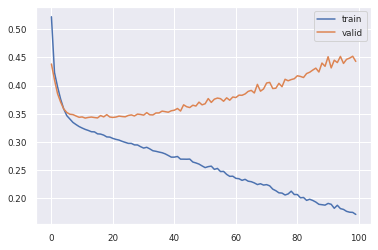

In [105]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch

plt.plot(hist['loss'])
plt.plot(hist['val_loss'])
plt.legend(("train", "valid"), loc=0)

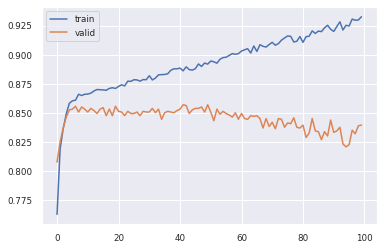

In [106]:
plt.plot(hist['binary_accuracy'])
plt.plot(hist['val_binary_accuracy'])
plt.legend(("train", "valid"), loc=0)

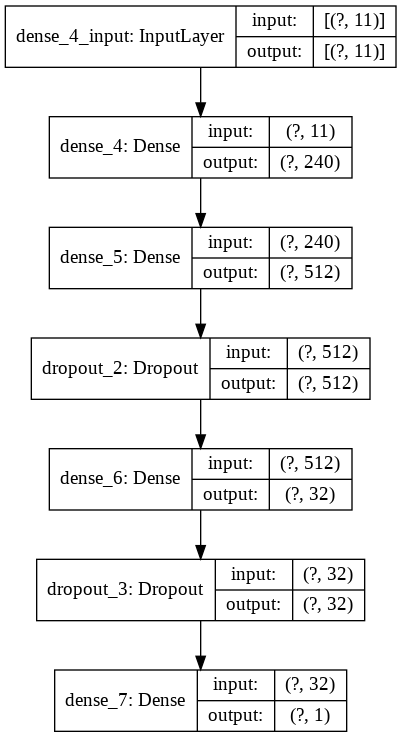

In [107]:
# Show the Model created

from keras.utils.vis_utils import plot_model

plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [108]:
results = model.evaluate(X_test, y_test.values)

63/63 [==============================] - 0s 2ms/step - loss: 0.4309 - binary_accuracy: 0.8465


In [109]:
print(model.metrics_names)
print(results)

['loss', 'binary_accuracy']
[0.4309260845184326, 0.8464999794960022]


In [110]:
y_pred_cls = model.predict_classes(X_test, batch_size=100, verbose=0)
print('Accuracy Model1 (Dropout): ' + str(model.evaluate(X_test, y_test.values)[1]))
print('Recall_score: ' + str(recall_score(y_test.values, y_pred_cls)))
print('Precision_score: ' + str(precision_score(y_test.values, y_pred_cls)))
print('F-score: ' + str(f1_score(y_test.values, y_pred_cls)))
confusion_matrix(y_test.values, y_pred_cls)

63/63 [==============================] - 0s 2ms/step - loss: 0.4309 - binary_accuracy: 0.8465
Accuracy Model1 (Dropout): 0.8464999794960022
Recall_score: 0.4963855421686747
Precision_score: 0.6776315789473685
F-score: 0.573018080667594


array([[1487,   98],
       [ 209,  206]])

In [111]:
# How loss moves around with each epoch

import hiplot as hip

data_vis = [{'epoch': idx,
             'loss': history.history['loss'][idx],
             'val_loss': history.history['val_loss'][idx],
             'binary_accuracy': history.history['binary_accuracy'][idx],
             'val_binary_accuracy': history.history['val_binary_accuracy'][idx],
             } for idx in range(num_epoch)]
hip.Experiment.from_iterable(data_vis).display()

<IPython.core.display.Javascript object>

##### Insight:
Based on the hiplot above, epoch 23 seems to be the best in this case.

#### Comparison:

In [112]:
tempResultsDf = pd.DataFrame({'Method': [model_name],
                          'Layer and Activation Function': [model_layer],
                          'Optimizer': [model_optimizer],
                          'Loss Func': [model_loss],
                          'Num of Epoc': [num_epoch],
                          'Num of Batch': [num_batch],
                          'Loss': [model.evaluate(X_test, y_test.values)[0]],
                          'Testing accuracy': [model.evaluate(X_test, y_test.values)[1]],
                          'Recall Score': [recall_score(y_test.values, y_pred_cls)],
                          'Precision Score': [precision_score(y_test.values, y_pred_cls)],
                          'F1 Score': [f1_score(y_test.values, y_pred_cls)],
                         })
resultsDf = pd.concat([resultsDf, tempResultsDf])
resultsDf = resultsDf[['Method', 'Layer and Activation Function', 'Optimizer', 'Loss Func', 'Num of Epoc','Num of Batch', 'Loss', 'Testing accuracy', 'Recall Score', 'Precision Score', 'F1 Score']]
print()
print()
resultsDf

63/63 [==============================] - 0s 2ms/step - loss: 0.4309 - binary_accuracy: 0.8465




,Method,Layer and Activation Function,Optimizer,Loss Func,Num of Epoc,Num of Batch,Loss,Testing accuracy,Recall Score,Precision Score,F1 Score
0,Model-1 (First Test),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,100,100,0.362033,0.8555,0.465060,0.742308,0.571852
0,Model-2 (Less number of Epocs),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,10,100,0.347334,0.8555,0.460241,0.746094,0.569300
0,Model-3 (Mid number of Epocs & Larger Batch),2HL 64_Relu-32_Tanh,Adam-LR_0.0001,binary_crossentropy,1000,2000,0.336002,0.8590,0.460241,0.767068,0.575301
0,Model-4 (Using the results from Hyperparameter...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,100,1000,0.430926,0.8465,0.496386,0.677632,0.573018


#### Insights:
Used the results from Hyperparameter but based on this number of epic and batch, the performance were not that good.

### Model-5 (Using the results from Hyperparameter Tuning w/ less Epoch)

#### Note
Try 40 Epoc & 4000 Batch

In [113]:
model_name = "Model-5 (Using the results from Hyperparameter Tuning w/ less Epoch)"
model_layer = "4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_Dropout"
model_optimizer = "Adam-LR_0.001"
model_loss = "binary_crossentropy"

num_epoch = 40
num_batch = 4000

In [114]:
model = Sequential()

model.add(Dense(240, input_shape=(X_ColNum, ), activation='tanh'))
model.add(Dense(512, activation='relu'))
model.add(Dropout(0.0))
model.add(Dense(32, activation='relu'))
model.add(Dropout(0.0))
model.add(Dense(1, activation='sigmoid'))

sgd = optimizers.Adam(lr=0.001)

# Use 0.5 as a threshold

tf.keras.metrics.BinaryAccuracy(
    name='binary_accuracy', dtype=None, threshold=0.5
)

model.compile(optimizer=sgd, loss='binary_crossentropy', metrics=[tf.keras.metrics.BinaryAccuracy()])

model.summary()

history = model.fit(X_train, y_train.values, batch_size=num_batch, epochs=num_epoch, verbose=1, validation_split=0.2)

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_8 (Dense)              (None, 240)               2880      
_________________________________________________________________
dense_9 (Dense)              (None, 512)               123392    
_________________________________________________________________
dropout_4 (Dropout)          (None, 512)               0         
_________________________________________________________________
dense_10 (Dense)             (None, 32)                16416     
_________________________________________________________________
dropout_5 (Dropout)          (None, 32)                0         
_________________________________________________________________
dense_11 (Dense)             (None, 1)                 33        
Total params: 142,721
Trainable params: 142,721
Non-trainable params: 0
________________________________________________

In [115]:
history.history.keys()

dict_keys(['loss', 'binary_accuracy', 'val_loss', 'val_binary_accuracy'])

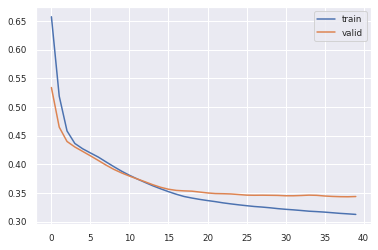

In [116]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch

plt.plot(hist['loss'])
plt.plot(hist['val_loss'])
plt.legend(("train", "valid"), loc=0)

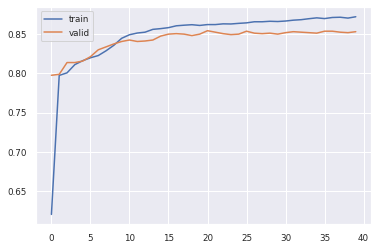

In [117]:
plt.plot(hist['binary_accuracy'])
plt.plot(hist['val_binary_accuracy'])
plt.legend(("train", "valid"), loc=0)

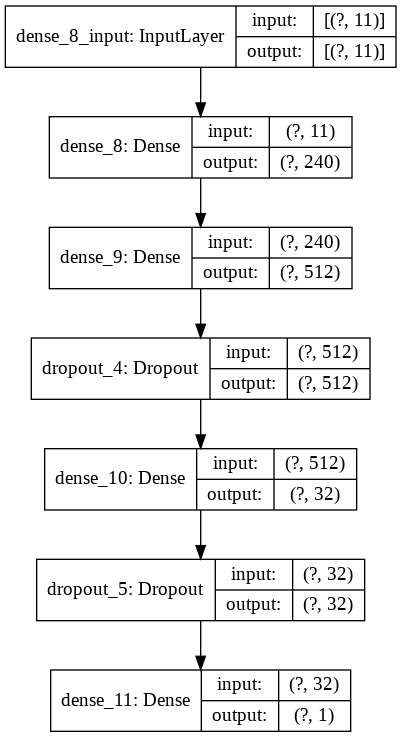

In [118]:
# Show the Model created

from keras.utils.vis_utils import plot_model

plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [119]:
results = model.evaluate(X_test, y_test.values)

63/63 [==============================] - 0s 2ms/step - loss: 0.3348 - binary_accuracy: 0.8620


In [120]:
print(model.metrics_names)
print(results)

['loss', 'binary_accuracy']
[0.33476153016090393, 0.8619999885559082]


In [121]:
y_pred_cls = model.predict_classes(X_test, batch_size=100, verbose=0)
print('Accuracy Model1 (Dropout): ' + str(model.evaluate(X_test, y_test.values)[1]))
print('Recall_score: ' + str(recall_score(y_test.values, y_pred_cls)))
print('Precision_score: ' + str(precision_score(y_test.values, y_pred_cls)))
print('F-score: ' + str(f1_score(y_test.values, y_pred_cls)))
confusion_matrix(y_test.values, y_pred_cls)

63/63 [==============================] - 0s 2ms/step - loss: 0.3348 - binary_accuracy: 0.8620
Accuracy Model1 (Dropout): 0.8619999885559082
Recall_score: 0.45542168674698796
Precision_score: 0.7907949790794979
F-score: 0.5779816513761468


array([[1535,   50],
       [ 226,  189]])

In [122]:
# How loss moves around with each epoch

import hiplot as hip

data_vis = [{'epoch': idx,
             'loss': history.history['loss'][idx],
             'val_loss': history.history['val_loss'][idx],
             'binary_accuracy': history.history['binary_accuracy'][idx],
             'val_binary_accuracy': history.history['val_binary_accuracy'][idx],
             } for idx in range(num_epoch)]
hip.Experiment.from_iterable(data_vis).display()

<IPython.core.display.Javascript object>

In [123]:
tempResultsDf = pd.DataFrame({'Method': [model_name],
                          'Layer and Activation Function': [model_layer],
                          'Optimizer': [model_optimizer],
                          'Loss Func': [model_loss],
                          'Num of Epoc': [num_epoch],
                          'Num of Batch': [num_batch],
                          'Loss': [model.evaluate(X_test, y_test.values)[0]],
                          'Testing accuracy': [model.evaluate(X_test, y_test.values)[1]],
                          'Recall Score': [recall_score(y_test.values, y_pred_cls)],
                          'Precision Score': [precision_score(y_test.values, y_pred_cls)],
                          'F1 Score': [f1_score(y_test.values, y_pred_cls)],
                         })
resultsDf = pd.concat([resultsDf, tempResultsDf])
resultsDf = resultsDf[['Method', 'Layer and Activation Function', 'Optimizer', 'Loss Func', 'Num of Epoc','Num of Batch', 'Loss', 'Testing accuracy', 'Recall Score', 'Precision Score', 'F1 Score']]
print()
print()
resultsDf

63/63 [==============================] - 0s 2ms/step - loss: 0.3348 - binary_accuracy: 0.8620




,Method,Layer and Activation Function,Optimizer,Loss Func,Num of Epoc,Num of Batch,Loss,Testing accuracy,Recall Score,Precision Score,F1 Score
0,Model-1 (First Test),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,100,100,0.362033,0.8555,0.465060,0.742308,0.571852
0,Model-2 (Less number of Epocs),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,10,100,0.347334,0.8555,0.460241,0.746094,0.569300
0,Model-3 (Mid number of Epocs & Larger Batch),2HL 64_Relu-32_Tanh,Adam-LR_0.0001,binary_crossentropy,1000,2000,0.336002,0.8590,0.460241,0.767068,0.575301
0,Model-4 (Using the results from Hyperparameter...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,100,1000,0.430926,0.8465,0.496386,0.677632,0.573018
0,Model-5 (Using the results from Hyperparameter...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,0.334762,0.8620,0.455422,0.790795,0.577982


#### Insight:
Adjusting the number of epoc and batch with the results from Hyperparameter Tuning resulted in better loss and accuracy.

### Model-6 (Trying initializers)

#### Note
Try 40 Epoc & 1000 Batch

In [124]:
from tensorflow.keras import initializers

In [125]:
model_name = "Model-6 (Trying initializer)"
model_layer = "4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_Dropout"
model_optimizer = "Adam-LR_0.001"
model_loss = "binary_crossentropy"

num_epoch = 40
num_batch = 1000

In [126]:
model = Sequential()

model.add(Dense(240, kernel_initializer=initializers.RandomNormal(mean=0.0, stddev=1.0), bias_initializer=initializers.Zeros(),input_shape=(X_ColNum, ), activation='tanh'))
model.add(Dense(512, kernel_initializer=initializers.RandomNormal(mean=0.0, stddev=1.0), bias_initializer=initializers.Zeros(), activation='relu'))
model.add(Dropout(0.0))
model.add(Dense(32, kernel_initializer=initializers.RandomNormal(mean=0.0, stddev=1.0), bias_initializer=initializers.Zeros(), activation='relu'))
model.add(Dropout(0.0))
model.add(Dense(1, activation='sigmoid'))

sgd = optimizers.Adam(lr=0.001)

# Use 0.5 as a threshold

tf.keras.metrics.BinaryAccuracy(
    name='binary_accuracy', dtype=None, threshold=0.5
)

model.compile(optimizer=sgd, loss='binary_crossentropy', metrics=[tf.keras.metrics.BinaryAccuracy()])

model.summary()

history = model.fit(X_train, y_train.values, batch_size=num_batch, epochs=num_epoch, verbose=1, validation_split=0.2)

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_12 (Dense)             (None, 240)               2880      
_________________________________________________________________
dense_13 (Dense)             (None, 512)               123392    
_________________________________________________________________
dropout_6 (Dropout)          (None, 512)               0         
_________________________________________________________________
dense_14 (Dense)             (None, 32)                16416     
_________________________________________________________________
dropout_7 (Dropout)          (None, 32)                0         
_________________________________________________________________
dense_15 (Dense)             (None, 1)                 33        
Total params: 142,721
Trainable params: 142,721
Non-trainable params: 0
________________________________________________

In [127]:
history.history.keys()

dict_keys(['loss', 'binary_accuracy', 'val_loss', 'val_binary_accuracy'])

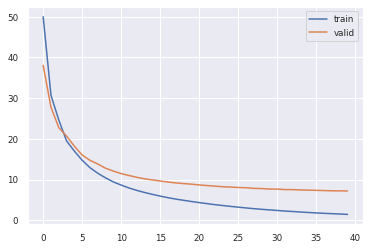

In [128]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch

plt.plot(hist['loss'])
plt.plot(hist['val_loss'])
plt.legend(("train", "valid"), loc=0)

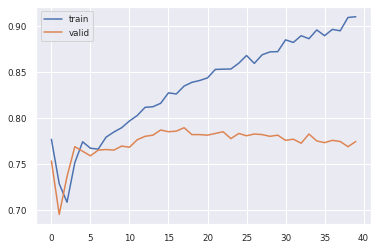

In [129]:
plt.plot(hist['binary_accuracy'])
plt.plot(hist['val_binary_accuracy'])
plt.legend(("train", "valid"), loc=0)

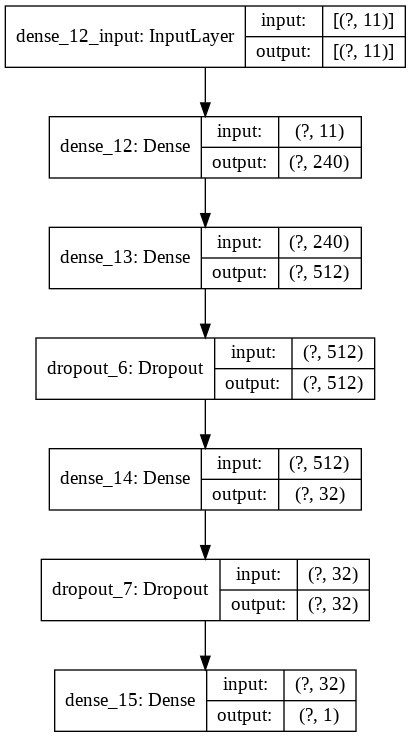

In [130]:
# Show the Model created

from keras.utils.vis_utils import plot_model

plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [131]:
results = model.evaluate(X_test, y_test.values)

63/63 [==============================] - 0s 2ms/step - loss: 7.8035 - binary_accuracy: 0.7670


In [132]:
print(model.metrics_names)
print(results)

['loss', 'binary_accuracy']
[7.803478240966797, 0.7670000195503235]


In [133]:
y_pred_cls = model.predict_classes(X_test, batch_size=100, verbose=0)
print('Accuracy Model1 (Dropout): ' + str(model.evaluate(X_test, y_test.values)[1]))
print('Recall_score: ' + str(recall_score(y_test.values, y_pred_cls)))
print('Precision_score: ' + str(precision_score(y_test.values, y_pred_cls)))
print('F-score: ' + str(f1_score(y_test.values, y_pred_cls)))
confusion_matrix(y_test.values, y_pred_cls)

63/63 [==============================] - 0s 2ms/step - loss: 7.8035 - binary_accuracy: 0.7670
Accuracy Model1 (Dropout): 0.7670000195503235
Recall_score: 0.4457831325301205
Precision_score: 0.43942992874109266
F-score: 0.4425837320574163


array([[1349,  236],
       [ 230,  185]])

In [134]:
# How loss moves around with each epoch

import hiplot as hip

data_vis = [{'epoch': idx,
             'loss': history.history['loss'][idx],
             'val_loss': history.history['val_loss'][idx],
             'binary_accuracy': history.history['binary_accuracy'][idx],
             'val_binary_accuracy': history.history['val_binary_accuracy'][idx],
             } for idx in range(num_epoch)]
hip.Experiment.from_iterable(data_vis).display()

<IPython.core.display.Javascript object>

In [135]:
tempResultsDf = pd.DataFrame({'Method': [model_name],
                          'Layer and Activation Function': [model_layer],
                          'Optimizer': [model_optimizer],
                          'Loss Func': [model_loss],
                          'Num of Epoc': [num_epoch],
                          'Num of Batch': [num_batch],
                          'Loss': [model.evaluate(X_test, y_test.values)[0]],
                          'Testing accuracy': [model.evaluate(X_test, y_test.values)[1]],
                          'Recall Score': [recall_score(y_test.values, y_pred_cls)],
                          'Precision Score': [precision_score(y_test.values, y_pred_cls)],
                          'F1 Score': [f1_score(y_test.values, y_pred_cls)],
                         })
resultsDf = pd.concat([resultsDf, tempResultsDf])
resultsDf = resultsDf[['Method', 'Layer and Activation Function', 'Optimizer', 'Loss Func', 'Num of Epoc','Num of Batch', 'Loss', 'Testing accuracy', 'Recall Score', 'Precision Score', 'F1 Score']]
print()
print()
resultsDf

63/63 [==============================] - 0s 2ms/step - loss: 7.8035 - binary_accuracy: 0.7670




,Method,Layer and Activation Function,Optimizer,Loss Func,Num of Epoc,Num of Batch,Loss,Testing accuracy,Recall Score,Precision Score,F1 Score
0,Model-1 (First Test),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,100,100,0.362033,0.8555,0.465060,0.742308,0.571852
0,Model-2 (Less number of Epocs),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,10,100,0.347334,0.8555,0.460241,0.746094,0.569300
0,Model-3 (Mid number of Epocs & Larger Batch),2HL 64_Relu-32_Tanh,Adam-LR_0.0001,binary_crossentropy,1000,2000,0.336002,0.8590,0.460241,0.767068,0.575301
0,Model-4 (Using the results from Hyperparameter...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,100,1000,0.430926,0.8465,0.496386,0.677632,0.573018
0,Model-5 (Using the results from Hyperparameter...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,0.334762,0.8620,0.455422,0.790795,0.577982
0,Model-6 (Trying initializer),4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,1000,7.803478,0.7670,0.445783,0.439430,0.442584


#### Insight:
Tried adding initializer to multiple layers but didn't resulted good in this case.

### Model-7 (Trying K-init RandomNormal, B-init RandomNormal for only 1st layer)

#### Note
Try 40 Epoc & 4000 Batch

In [136]:
model_name = "Model-7 (Trying K-init RandomNormal, B-init RandomNormal for only 1st layer)"
model_layer = "4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_Dropout"
model_optimizer = "Adam-LR_0.001"
model_loss = "binary_crossentropy"

num_epoch = 40
num_batch = 4000

In [137]:
model = Sequential()

model.add(Dense(240, kernel_initializer=initializers.RandomNormal(mean=0.0, stddev=1.0), bias_initializer=initializers.RandomNormal(mean=0.0, stddev=1.0),input_shape=(X_ColNum, ), activation='tanh'))
model.add(Dense(512, activation='relu'))
model.add(Dropout(0.0))
model.add(Dense(32, activation='relu'))
model.add(Dropout(0.0))
model.add(Dense(1, activation='sigmoid'))

sgd = optimizers.Adam(lr=0.001)

# Use 0.5 as a threshold

tf.keras.metrics.BinaryAccuracy(
    name='binary_accuracy', dtype=None, threshold=0.5
)

model.compile(optimizer=sgd, loss='binary_crossentropy', metrics=[tf.keras.metrics.BinaryAccuracy()])

model.summary()

history = model.fit(X_train, y_train.values, batch_size=num_batch, epochs=num_epoch, verbose=1, validation_split=0.2)

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_16 (Dense)             (None, 240)               2880      
_________________________________________________________________
dense_17 (Dense)             (None, 512)               123392    
_________________________________________________________________
dropout_8 (Dropout)          (None, 512)               0         
_________________________________________________________________
dense_18 (Dense)             (None, 32)                16416     
_________________________________________________________________
dropout_9 (Dropout)          (None, 32)                0         
_________________________________________________________________
dense_19 (Dense)             (None, 1)                 33        
Total params: 142,721
Trainable params: 142,721
Non-trainable params: 0
________________________________________________

In [138]:
history.history.keys()

dict_keys(['loss', 'binary_accuracy', 'val_loss', 'val_binary_accuracy'])

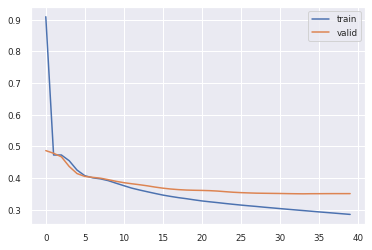

In [139]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch

plt.plot(hist['loss'])
plt.plot(hist['val_loss'])
plt.legend(("train", "valid"), loc=0)

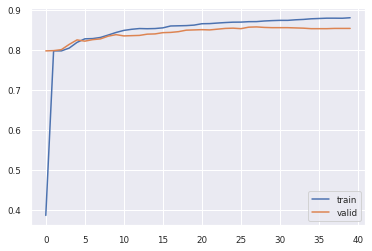

In [140]:
plt.plot(hist['binary_accuracy'])
plt.plot(hist['val_binary_accuracy'])
plt.legend(("train", "valid"), loc=0)

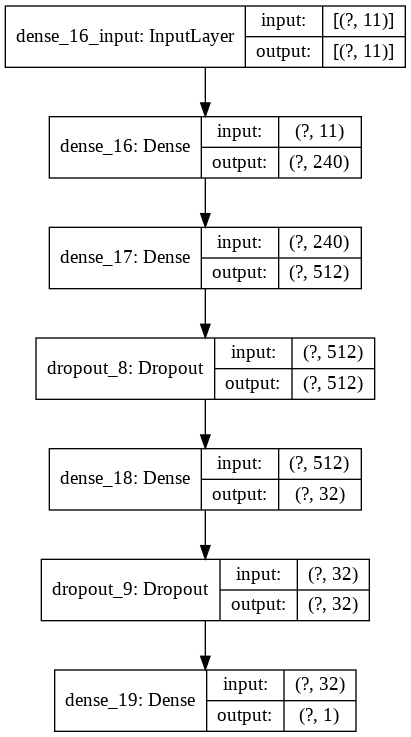

In [141]:
# Show the Model created

from keras.utils.vis_utils import plot_model

plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [142]:
results = model.evaluate(X_test, y_test.values)

63/63 [==============================] - 0s 2ms/step - loss: 0.3397 - binary_accuracy: 0.8570


In [143]:
print(model.metrics_names)
print(results)

['loss', 'binary_accuracy']
[0.33969277143478394, 0.8569999933242798]


In [144]:
y_pred_cls = model.predict_classes(X_test, batch_size=num_batch, verbose=0)
print('Accuracy Model1 (Dropout): ' + str(model.evaluate(X_test, y_test.values)[1]))
print('Recall_score: ' + str(recall_score(y_test.values, y_pred_cls)))
print('Precision_score: ' + str(precision_score(y_test.values, y_pred_cls)))
print('F-score: ' + str(f1_score(y_test.values, y_pred_cls)))
confusion_matrix(y_test.values, y_pred_cls)

63/63 [==============================] - 0s 2ms/step - loss: 0.3397 - binary_accuracy: 0.8570
Accuracy Model1 (Dropout): 0.8569999933242798
Recall_score: 0.4746987951807229
Precision_score: 0.7433962264150943
F-score: 0.5794117647058824


array([[1517,   68],
       [ 218,  197]])

In [145]:
# How loss moves around with each epoch

import hiplot as hip

data_vis = [{'epoch': idx,
             'loss': history.history['loss'][idx],
             'val_loss': history.history['val_loss'][idx],
             'binary_accuracy': history.history['binary_accuracy'][idx],
             'val_binary_accuracy': history.history['val_binary_accuracy'][idx],
             } for idx in range(num_epoch)]
hip.Experiment.from_iterable(data_vis).display()

<IPython.core.display.Javascript object>

In [146]:
tempResultsDf = pd.DataFrame({'Method': [model_name],
                          'Layer and Activation Function': [model_layer],
                          'Optimizer': [model_optimizer],
                          'Loss Func': [model_loss],
                          'Num of Epoc': [num_epoch],
                          'Num of Batch': [num_batch],
                          'Loss': [model.evaluate(X_test, y_test.values)[0]],
                          'Testing accuracy': [model.evaluate(X_test, y_test.values)[1]],
                          'Recall Score': [recall_score(y_test.values, y_pred_cls)],
                          'Precision Score': [precision_score(y_test.values, y_pred_cls)],
                          'F1 Score': [f1_score(y_test.values, y_pred_cls)],
                         })
resultsDf = pd.concat([resultsDf, tempResultsDf])
resultsDf = resultsDf[['Method', 'Layer and Activation Function', 'Optimizer', 'Loss Func', 'Num of Epoc','Num of Batch', 'Loss', 'Testing accuracy', 'Recall Score', 'Precision Score', 'F1 Score']]
print()
print()
resultsDf

63/63 [==============================] - 0s 2ms/step - loss: 0.3397 - binary_accuracy: 0.8570




,Method,Layer and Activation Function,Optimizer,Loss Func,Num of Epoc,Num of Batch,Loss,Testing accuracy,Recall Score,Precision Score,F1 Score
0,Model-1 (First Test),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,100,100,0.362033,0.8555,0.465060,0.742308,0.571852
0,Model-2 (Less number of Epocs),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,10,100,0.347334,0.8555,0.460241,0.746094,0.569300
0,Model-3 (Mid number of Epocs & Larger Batch),2HL 64_Relu-32_Tanh,Adam-LR_0.0001,binary_crossentropy,1000,2000,0.336002,0.8590,0.460241,0.767068,0.575301
0,Model-4 (Using the results from Hyperparameter...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,100,1000,0.430926,0.8465,0.496386,0.677632,0.573018
0,Model-5 (Using the results from Hyperparameter...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,0.334762,0.8620,0.455422,0.790795,0.577982
0,Model-6 (Trying initializer),4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,1000,7.803478,0.7670,0.445783,0.439430,0.442584
0,"Model-7 (Trying K-init RandomNormal, B-init Ra...",4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,0.339693,0.8570,0.474699,0.743396,0.579412


#### Insight:
Adding initializer only to the first layer resulted better result

### Model-8 (Trying K-init RandomNormal, B-init RandomNormal in three layers)

#### Note
Try 40 Epoc & 4000 Batch

In [147]:
model_name = "Model-8 (Trying K-init RandomNormal, B-init RandomNormal in three layers)"
model_layer = "4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_Dropout"
model_optimizer = "Adam-LR_0.001"
model_loss = "binary_crossentropy"

num_epoch = 40
num_batch = 4000

In [148]:
model = Sequential()

model.add(Dense(240, kernel_initializer=initializers.RandomNormal(mean=0.0, stddev=1.0), bias_initializer=initializers.RandomNormal(mean=0.0, stddev=1.0),input_shape=(X_ColNum, ), activation='tanh'))
model.add(Dense(512, kernel_initializer=initializers.RandomNormal(mean=0.0, stddev=1.0), bias_initializer=initializers.RandomNormal(mean=0.0, stddev=1.0), activation='relu'))
model.add(Dropout(0.0))
model.add(Dense(32, kernel_initializer=initializers.RandomNormal(mean=0.0, stddev=1.0), bias_initializer=initializers.RandomNormal(mean=0.0, stddev=1.0), activation='relu'))
model.add(Dropout(0.0))
model.add(Dense(1, activation='sigmoid'))

sgd = optimizers.Adam(lr=0.001)

# Use 0.5 as a threshold

tf.keras.metrics.BinaryAccuracy(
    name='binary_accuracy', dtype=None, threshold=0.5
)

model.compile(optimizer=sgd, loss='binary_crossentropy', metrics=[tf.keras.metrics.BinaryAccuracy()])

model.summary()

history = model.fit(X_train, y_train.values, batch_size=num_batch, epochs=num_epoch, verbose=1, validation_split=0.2)

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_20 (Dense)             (None, 240)               2880      
_________________________________________________________________
dense_21 (Dense)             (None, 512)               123392    
_________________________________________________________________
dropout_10 (Dropout)         (None, 512)               0         
_________________________________________________________________
dense_22 (Dense)             (None, 32)                16416     
_________________________________________________________________
dropout_11 (Dropout)         (None, 32)                0         
_________________________________________________________________
dense_23 (Dense)             (None, 1)                 33        
Total params: 142,721
Trainable params: 142,721
Non-trainable params: 0
________________________________________________

In [149]:
history.history.keys()

dict_keys(['loss', 'binary_accuracy', 'val_loss', 'val_binary_accuracy'])

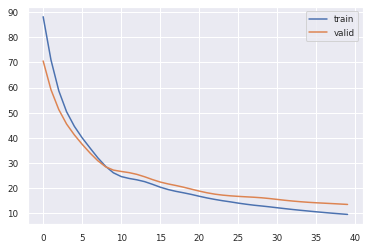

In [150]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch

plt.plot(hist['loss'])
plt.plot(hist['val_loss'])
plt.legend(("train", "valid"), loc=0)

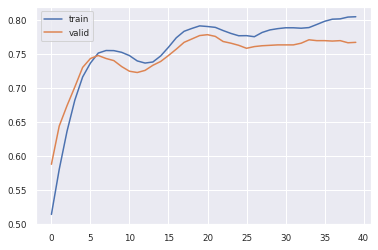

In [151]:
plt.plot(hist['binary_accuracy'])
plt.plot(hist['val_binary_accuracy'])
plt.legend(("train", "valid"), loc=0)

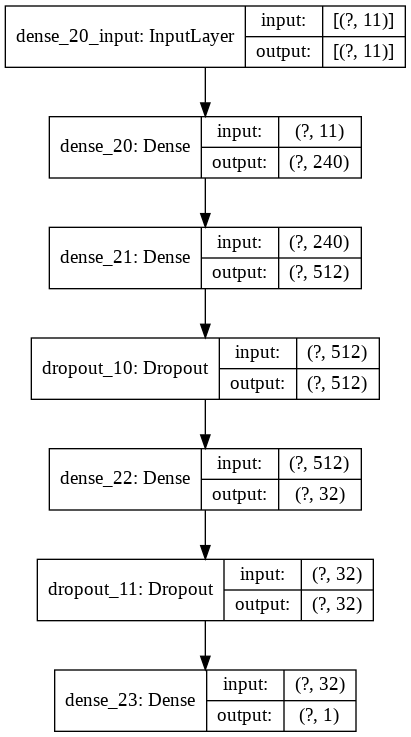

In [152]:
# Show the Model created

from keras.utils.vis_utils import plot_model

plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [153]:
results = model.evaluate(X_test, y_test.values)

63/63 [==============================] - 0s 2ms/step - loss: 13.4991 - binary_accuracy: 0.7705


In [154]:
print(model.metrics_names)
print(results)

['loss', 'binary_accuracy']
[13.499107360839844, 0.7705000042915344]


In [155]:
y_pred_cls = model.predict_classes(X_test, batch_size=100, verbose=0)
print('Accuracy Model1 (Dropout): ' + str(model.evaluate(X_test, y_test.values)[1]))
print('Recall_score: ' + str(recall_score(y_test.values, y_pred_cls)))
print('Precision_score: ' + str(precision_score(y_test.values, y_pred_cls)))
print('F-score: ' + str(f1_score(y_test.values, y_pred_cls)))
confusion_matrix(y_test.values, y_pred_cls)

63/63 [==============================] - 0s 2ms/step - loss: 13.4991 - binary_accuracy: 0.7705
Accuracy Model1 (Dropout): 0.7705000042915344
Recall_score: 0.43855421686746987
Precision_score: 0.44607843137254904
F-score: 0.4422843256379101


array([[1359,  226],
       [ 233,  182]])

In [156]:
# How loss moves around with each epoch

import hiplot as hip

data_vis = [{'epoch': idx,
             'loss': history.history['loss'][idx],
             'val_loss': history.history['val_loss'][idx],
             'binary_accuracy': history.history['binary_accuracy'][idx],
             'val_binary_accuracy': history.history['val_binary_accuracy'][idx],
             } for idx in range(num_epoch)]
hip.Experiment.from_iterable(data_vis).display()

<IPython.core.display.Javascript object>

In [157]:
tempResultsDf = pd.DataFrame({'Method': [model_name],
                          'Layer and Activation Function': [model_layer],
                          'Optimizer': [model_optimizer],
                          'Loss Func': [model_loss],
                          'Num of Epoc': [num_epoch],
                          'Num of Batch': [num_batch],
                          'Loss': [model.evaluate(X_test, y_test.values)[0]],
                          'Testing accuracy': [model.evaluate(X_test, y_test.values)[1]],
                          'Recall Score': [recall_score(y_test.values, y_pred_cls)],
                          'Precision Score': [precision_score(y_test.values, y_pred_cls)],
                          'F1 Score': [f1_score(y_test.values, y_pred_cls)],
                         })
resultsDf = pd.concat([resultsDf, tempResultsDf])
resultsDf = resultsDf[['Method', 'Layer and Activation Function', 'Optimizer', 'Loss Func', 'Num of Epoc','Num of Batch', 'Loss', 'Testing accuracy', 'Recall Score', 'Precision Score', 'F1 Score']]
print()
print()
resultsDf

63/63 [==============================] - 0s 2ms/step - loss: 13.4991 - binary_accuracy: 0.7705




,Method,Layer and Activation Function,Optimizer,Loss Func,Num of Epoc,Num of Batch,Loss,Testing accuracy,Recall Score,Precision Score,F1 Score
0,Model-1 (First Test),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,100,100,0.362033,0.8555,0.465060,0.742308,0.571852
0,Model-2 (Less number of Epocs),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,10,100,0.347334,0.8555,0.460241,0.746094,0.569300
0,Model-3 (Mid number of Epocs & Larger Batch),2HL 64_Relu-32_Tanh,Adam-LR_0.0001,binary_crossentropy,1000,2000,0.336002,0.8590,0.460241,0.767068,0.575301
0,Model-4 (Using the results from Hyperparameter...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,100,1000,0.430926,0.8465,0.496386,0.677632,0.573018
0,Model-5 (Using the results from Hyperparameter...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,0.334762,0.8620,0.455422,0.790795,0.577982
0,Model-6 (Trying initializer),4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,1000,7.803478,0.7670,0.445783,0.439430,0.442584
0,"Model-7 (Trying K-init RandomNormal, B-init Ra...",4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,0.339693,0.8570,0.474699,0.743396,0.579412
0,"Model-8 (Trying K-init RandomNormal, B-init Ra...",4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,13.499107,0.7705,0.438554,0.446078,0.442284


#### Insight:
Adding randomnormal initializer to three layers resulted bad results

# Try PCA (9)

In [158]:
from sklearn.decomposition import PCA

In [159]:
num_pca = 9

In [160]:
type(X_data)

pandas.core.frame.DataFrame

In [161]:
type(X_train)

numpy.ndarray

In [162]:
X_train[0]

array([-0.23082038, -0.94449979, -0.70174202,  0.58817274,  0.80225696,
       -1.55337352,  0.97725852,  0.42739449,  1.71490137, -0.57273139,
        0.91509065])

In [163]:
type(X_test)

numpy.ndarray

In [164]:
pca = PCA(n_components=num_pca)
pca.fit(X_train)

PCA(copy=True, iterated_power='auto', n_components=9, random_state=None,
    svd_solver='auto', tol=0.0, whiten=False)

In [165]:
X_train_pca = pca.transform(X_train)

In [166]:
X_train[0]

array([-0.23082038, -0.94449979, -0.70174202,  0.58817274,  0.80225696,
       -1.55337352,  0.97725852,  0.42739449,  1.71490137, -0.57273139,
        0.91509065])

In [167]:
X_train_pca[0]

array([-1.26940822, -0.49343148,  0.72131192,  0.52098689, -1.65001657,
        0.637283  , -1.20113532,  1.0339627 , -0.95982132])

In [168]:
X_test_pca = pca.transform(X_test)

In [169]:
X_test[0]

array([-1.03768121,  0.77498705, -1.0482813 , -1.22599173,  0.80225696,
        0.64376017,  0.97725852, -0.05360571, -0.58312392, -0.57273139,
        0.91509065])

In [170]:
X_test_pca[0]

array([ 1.03948963,  0.03174238,  1.16711038, -0.38274533,  0.31195259,
        1.36463223, -1.58516045, -0.51989716,  0.19331737])

### Model-9 (PCA & results from Hyperparameter Tuning)

#### Note
Try 50 Epoc & 4000 Batch

In [171]:
model_name = "Model-9 (PCA & results from Hyperparameter Tuning)"
model_layer = "4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_Dropout"
model_optimizer = "Adam-LR_0.001"
model_loss = "binary_crossentropy"

num_epoch = 50
num_batch = 4000

X_ColNum_bak = X_ColNum
X_ColNum = num_pca

X_train_bak = X_train.copy()
X_train = X_train_pca

X_test_bak = X_test.copy()
X_test = X_test_pca


In [172]:
model = Sequential()

model.add(Dense(240, input_shape=(X_ColNum, ), activation='tanh'))
model.add(Dense(512, activation='relu'))
model.add(Dropout(0.0))
model.add(Dense(32, activation='relu'))
model.add(Dropout(0.0))
model.add(Dense(1, activation='sigmoid'))

sgd = optimizers.Adam(lr=0.001)

# Use 0.5 as a threshold

tf.keras.metrics.BinaryAccuracy(
    name='binary_accuracy', dtype=None, threshold=0.5
)

model.compile(optimizer=sgd, loss='binary_crossentropy', metrics=[tf.keras.metrics.BinaryAccuracy()])

model.summary()

history = model.fit(X_train, y_train.values, batch_size=num_batch, epochs=num_epoch, verbose=1, validation_split=0.2)

Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_24 (Dense)             (None, 240)               2400      
_________________________________________________________________
dense_25 (Dense)             (None, 512)               123392    
_________________________________________________________________
dropout_12 (Dropout)         (None, 512)               0         
_________________________________________________________________
dense_26 (Dense)             (None, 32)                16416     
_________________________________________________________________
dropout_13 (Dropout)         (None, 32)                0         
_________________________________________________________________
dense_27 (Dense)             (None, 1)                 33        
Total params: 142,241
Trainable params: 142,241
Non-trainable params: 0
________________________________________________

In [173]:
history.history.keys()

dict_keys(['loss', 'binary_accuracy', 'val_loss', 'val_binary_accuracy'])

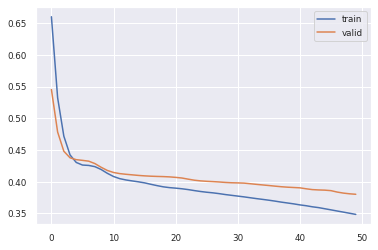

In [174]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch

plt.plot(hist['loss'])
plt.plot(hist['val_loss'])
plt.legend(("train", "valid"), loc=0)

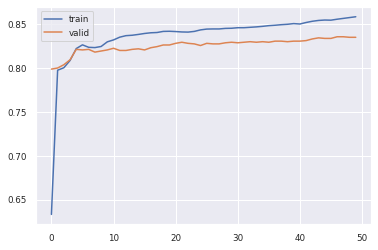

In [175]:
plt.plot(hist['binary_accuracy'])
plt.plot(hist['val_binary_accuracy'])
plt.legend(("train", "valid"), loc=0)

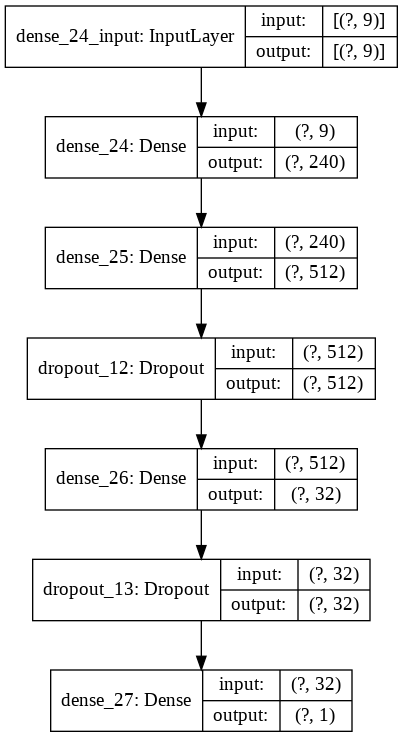

In [176]:
# Show the Model created

from keras.utils.vis_utils import plot_model

plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [177]:
results = model.evaluate(X_test, y_test.values)

63/63 [==============================] - 0s 2ms/step - loss: 0.3647 - binary_accuracy: 0.8510


In [178]:
print(model.metrics_names)
print(results)

['loss', 'binary_accuracy']
[0.3646925091743469, 0.8510000109672546]


In [179]:
y_pred_cls = model.predict_classes(X_test, batch_size=num_batch, verbose=0)
print('Accuracy Model1 (Dropout): ' + str(model.evaluate(X_test, y_test.values)[1]))
print('Recall_score: ' + str(recall_score(y_test.values, y_pred_cls)))
print('Precision_score: ' + str(precision_score(y_test.values, y_pred_cls)))
print('F-score: ' + str(f1_score(y_test.values, y_pred_cls)))
confusion_matrix(y_test.values, y_pred_cls)

63/63 [==============================] - 0s 2ms/step - loss: 0.3647 - binary_accuracy: 0.8510
Accuracy Model1 (Dropout): 0.8510000109672546
Recall_score: 0.39759036144578314
Precision_score: 0.7746478873239436
F-score: 0.5254777070063694


array([[1537,   48],
       [ 250,  165]])

In [180]:
# How loss moves around with each epoch

import hiplot as hip

data_vis = [{'epoch': idx,
             'loss': history.history['loss'][idx],
             'val_loss': history.history['val_loss'][idx],
             'binary_accuracy': history.history['binary_accuracy'][idx],
             'val_binary_accuracy': history.history['val_binary_accuracy'][idx],
             } for idx in range(num_epoch)]
hip.Experiment.from_iterable(data_vis).display()

<IPython.core.display.Javascript object>

In [181]:
tempResultsDf = pd.DataFrame({'Method': [model_name],
                          'Layer and Activation Function': [model_layer],
                          'Optimizer': [model_optimizer],
                          'Loss Func': [model_loss],
                          'Num of Epoc': [num_epoch],
                          'Num of Batch': [num_batch],
                          'Loss': [model.evaluate(X_test, y_test.values)[0]],
                          'Testing accuracy': [model.evaluate(X_test, y_test.values)[1]],
                          'Recall Score': [recall_score(y_test.values, y_pred_cls)],
                          'Precision Score': [precision_score(y_test.values, y_pred_cls)],
                          'F1 Score': [f1_score(y_test.values, y_pred_cls)],
                         })
resultsDf = pd.concat([resultsDf, tempResultsDf])
resultsDf = resultsDf[['Method', 'Layer and Activation Function', 'Optimizer', 'Loss Func', 'Num of Epoc','Num of Batch', 'Loss', 'Testing accuracy', 'Recall Score', 'Precision Score', 'F1 Score']]
print()
print()
resultsDf

63/63 [==============================] - 0s 2ms/step - loss: 0.3647 - binary_accuracy: 0.8510




,Method,Layer and Activation Function,Optimizer,Loss Func,Num of Epoc,Num of Batch,Loss,Testing accuracy,Recall Score,Precision Score,F1 Score
0,Model-1 (First Test),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,100,100,0.362033,0.8555,0.465060,0.742308,0.571852
0,Model-2 (Less number of Epocs),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,10,100,0.347334,0.8555,0.460241,0.746094,0.569300
0,Model-3 (Mid number of Epocs & Larger Batch),2HL 64_Relu-32_Tanh,Adam-LR_0.0001,binary_crossentropy,1000,2000,0.336002,0.8590,0.460241,0.767068,0.575301
0,Model-4 (Using the results from Hyperparameter...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,100,1000,0.430926,0.8465,0.496386,0.677632,0.573018
0,Model-5 (Using the results from Hyperparameter...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,0.334762,0.8620,0.455422,0.790795,0.577982
0,Model-6 (Trying initializer),4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,1000,7.803478,0.7670,0.445783,0.439430,0.442584
0,"Model-7 (Trying K-init RandomNormal, B-init Ra...",4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,0.339693,0.8570,0.474699,0.743396,0.579412
0,"Model-8 (Trying K-init RandomNormal, B-init Ra...",4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,13.499107,0.7705,0.438554,0.446078,0.442284
0,Model-9 (PCA & results from Hyperparameter Tun...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,50,4000,0.364693,0.8510,0.397590,0.774648,0.525478


#### Insight:
Comparing with Model-7 and 9, PCA with 9 components didn't improved the results

In [182]:
X_ColNum = X_ColNum_bak
X_train = X_train_bak.copy()
X_test = X_test_bak.copy()

### Model-10 (PCA & K-init RandomNormal, B-init RandomNormal for only 1st layer)

#### Note
Try 40 Epoc & 4000 Batch

In [183]:
model_name = "Model-10 (PCA & K-init RandomNormal, B-init RandomNormal for only 1st layer)"
model_layer = "4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_Dropout"
model_optimizer = "Adam-LR_0.001"
model_loss = "binary_crossentropy"

num_epoch = 40
num_batch = 4000

X_ColNum_bak = X_ColNum
X_ColNum = num_pca

X_train_bak = X_train.copy()
X_train = X_train_pca

X_test_bak = X_test.copy()
X_test = X_test_pca

In [184]:
model = Sequential()

model.add(Dense(240, kernel_initializer=initializers.RandomNormal(mean=0.0, stddev=1.0), bias_initializer=initializers.RandomNormal(mean=0.0, stddev=1.0),input_shape=(X_ColNum, ), activation='tanh'))
model.add(Dense(512, activation='relu'))
model.add(Dropout(0.0))
model.add(Dense(32, activation='relu'))
model.add(Dropout(0.0))
model.add(Dense(1, activation='sigmoid'))

sgd = optimizers.Adam(lr=0.001)

# Use 0.5 as a threshold

tf.keras.metrics.BinaryAccuracy(
    name='binary_accuracy', dtype=None, threshold=0.5
)

model.compile(optimizer=sgd, loss='binary_crossentropy', metrics=[tf.keras.metrics.BinaryAccuracy()])

model.summary()

history = model.fit(X_train, y_train.values, batch_size=num_batch, epochs=num_epoch, verbose=1, validation_split=0.2)

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_28 (Dense)             (None, 240)               2400      
_________________________________________________________________
dense_29 (Dense)             (None, 512)               123392    
_________________________________________________________________
dropout_14 (Dropout)         (None, 512)               0         
_________________________________________________________________
dense_30 (Dense)             (None, 32)                16416     
_________________________________________________________________
dropout_15 (Dropout)         (None, 32)                0         
_________________________________________________________________
dense_31 (Dense)             (None, 1)                 33        
Total params: 142,241
Trainable params: 142,241
Non-trainable params: 0
________________________________________________

In [185]:
history.history.keys()

dict_keys(['loss', 'binary_accuracy', 'val_loss', 'val_binary_accuracy'])

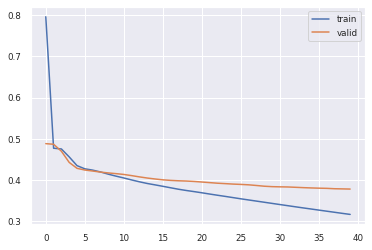

In [186]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch

plt.plot(hist['loss'])
plt.plot(hist['val_loss'])
plt.legend(("train", "valid"), loc=0)

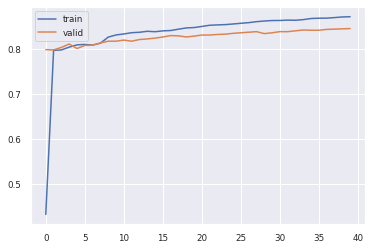

In [187]:
plt.plot(hist['binary_accuracy'])
plt.plot(hist['val_binary_accuracy'])
plt.legend(("train", "valid"), loc=0)

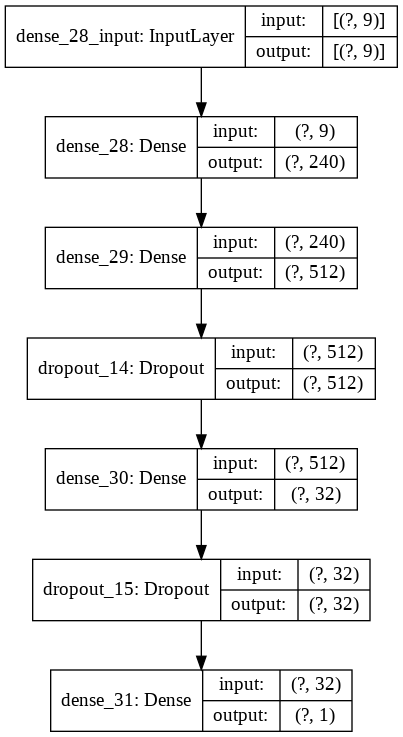

In [188]:
# Show the Model created

from keras.utils.vis_utils import plot_model

plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [189]:
results = model.evaluate(X_test, y_test.values)

63/63 [==============================] - 0s 2ms/step - loss: 0.3619 - binary_accuracy: 0.8520


In [190]:
print(model.metrics_names)
print(results)

['loss', 'binary_accuracy']
[0.3619263172149658, 0.8519999980926514]


In [191]:
y_pred_cls = model.predict_classes(X_test, batch_size=100, verbose=0)
print('Accuracy Model1 (Dropout): ' + str(model.evaluate(X_test, y_test.values)[1]))
print('Recall_score: ' + str(recall_score(y_test.values, y_pred_cls)))
print('Precision_score: ' + str(precision_score(y_test.values, y_pred_cls)))
print('F-score: ' + str(f1_score(y_test.values, y_pred_cls)))
confusion_matrix(y_test.values, y_pred_cls)

63/63 [==============================] - 0s 2ms/step - loss: 0.3619 - binary_accuracy: 0.8520
Accuracy Model1 (Dropout): 0.8519999980926514
Recall_score: 0.40240963855421685
Precision_score: 0.7767441860465116
F-score: 0.5301587301587302


array([[1537,   48],
       [ 248,  167]])

In [192]:
# How loss moves around with each epoch

import hiplot as hip

data_vis = [{'epoch': idx,
             'loss': history.history['loss'][idx],
             'val_loss': history.history['val_loss'][idx],
             'binary_accuracy': history.history['binary_accuracy'][idx],
             'val_binary_accuracy': history.history['val_binary_accuracy'][idx],
             } for idx in range(num_epoch)]
hip.Experiment.from_iterable(data_vis).display()

<IPython.core.display.Javascript object>

In [193]:
tempResultsDf = pd.DataFrame({'Method': [model_name],
                          'Layer and Activation Function': [model_layer],
                          'Optimizer': [model_optimizer],
                          'Loss Func': [model_loss],
                          'Num of Epoc': [num_epoch],
                          'Num of Batch': [num_batch],
                          'Loss': [model.evaluate(X_test, y_test.values)[0]],
                          'Testing accuracy': [model.evaluate(X_test, y_test.values)[1]],
                          'Recall Score': [recall_score(y_test.values, y_pred_cls)],
                          'Precision Score': [precision_score(y_test.values, y_pred_cls)],
                          'F1 Score': [f1_score(y_test.values, y_pred_cls)],
                         })
resultsDf = pd.concat([resultsDf, tempResultsDf])
resultsDf = resultsDf[['Method', 'Layer and Activation Function', 'Optimizer', 'Loss Func', 'Num of Epoc','Num of Batch', 'Loss', 'Testing accuracy', 'Recall Score', 'Precision Score', 'F1 Score']]
print()
print()
resultsDf

63/63 [==============================] - 0s 2ms/step - loss: 0.3619 - binary_accuracy: 0.8520




,Method,Layer and Activation Function,Optimizer,Loss Func,Num of Epoc,Num of Batch,Loss,Testing accuracy,Recall Score,Precision Score,F1 Score
0,Model-1 (First Test),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,100,100,0.362033,0.8555,0.465060,0.742308,0.571852
0,Model-2 (Less number of Epocs),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,10,100,0.347334,0.8555,0.460241,0.746094,0.569300
0,Model-3 (Mid number of Epocs & Larger Batch),2HL 64_Relu-32_Tanh,Adam-LR_0.0001,binary_crossentropy,1000,2000,0.336002,0.8590,0.460241,0.767068,0.575301
0,Model-4 (Using the results from Hyperparameter...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,100,1000,0.430926,0.8465,0.496386,0.677632,0.573018
0,Model-5 (Using the results from Hyperparameter...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,0.334762,0.8620,0.455422,0.790795,0.577982
0,Model-6 (Trying initializer),4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,1000,7.803478,0.7670,0.445783,0.439430,0.442584
0,"Model-7 (Trying K-init RandomNormal, B-init Ra...",4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,0.339693,0.8570,0.474699,0.743396,0.579412
0,"Model-8 (Trying K-init RandomNormal, B-init Ra...",4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,13.499107,0.7705,0.438554,0.446078,0.442284
0,Model-9 (PCA & results from Hyperparameter Tun...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,50,4000,0.364693,0.8510,0.397590,0.774648,0.525478
0,"Model-10 (PCA & K-init RandomNormal, B-init Ra...",4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,0.361926,0.8520,0.402410,0.776744,0.530159


#### Insight:
Tried both PCA and initializer but the results didn't improved 

In [194]:
X_ColNum = X_ColNum_bak
X_train = X_train_bak.copy()
X_test = X_test_bak.copy()

# Try PCA (6)

In [195]:
num_pca = 6

In [196]:
pca = PCA(n_components=num_pca)
pca.fit(X_train)

PCA(copy=True, iterated_power='auto', n_components=6, random_state=None,
    svd_solver='auto', tol=0.0, whiten=False)

In [197]:
X_train_pca = pca.transform(X_train)

In [198]:
X_test_pca = pca.transform(X_test)

### Model-11 (PCA6 & results from Hyperparameter Tuning)

#### Note
Try 50 Epoc & 4000 Batch

In [199]:
model_name = "Model-11 (PCA6 & results from Hyperparameter Tuning)"
model_layer = "4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_Dropout"
model_optimizer = "Adam-LR_0.001"
model_loss = "binary_crossentropy"

num_epoch = 100
num_batch = 4000

X_ColNum_bak = X_ColNum
X_ColNum = num_pca

X_train_bak = X_train.copy()
X_train = X_train_pca

X_test_bak = X_test.copy()
X_test = X_test_pca


In [200]:
model = Sequential()

model.add(Dense(240, input_shape=(X_ColNum, ), activation='tanh'))
model.add(Dense(512, activation='relu'))
model.add(Dropout(0.0))
model.add(Dense(32, activation='relu'))
model.add(Dropout(0.0))
model.add(Dense(1, activation='sigmoid'))

sgd = optimizers.Adam(lr=0.001)

# Use 0.5 as a threshold

tf.keras.metrics.BinaryAccuracy(
    name='binary_accuracy', dtype=None, threshold=0.5
)

model.compile(optimizer=sgd, loss='binary_crossentropy', metrics=[tf.keras.metrics.BinaryAccuracy()])

model.summary()

history = model.fit(X_train, y_train.values, batch_size=num_batch, epochs=num_epoch, verbose=1, validation_split=0.2)

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_32 (Dense)             (None, 240)               1680      
_________________________________________________________________
dense_33 (Dense)             (None, 512)               123392    
_________________________________________________________________
dropout_16 (Dropout)         (None, 512)               0         
_________________________________________________________________
dense_34 (Dense)             (None, 32)                16416     
_________________________________________________________________
dropout_17 (Dropout)         (None, 32)                0         
_________________________________________________________________
dense_35 (Dense)             (None, 1)                 33        
Total params: 141,521
Trainable params: 141,521
Non-trainable params: 0
________________________________________________

In [201]:
history.history.keys()

dict_keys(['loss', 'binary_accuracy', 'val_loss', 'val_binary_accuracy'])

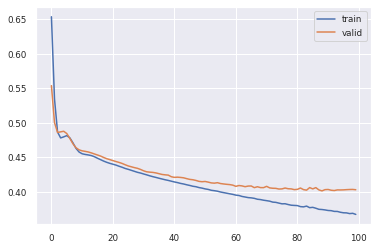

In [202]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch

plt.plot(hist['loss'])
plt.plot(hist['val_loss'])
plt.legend(("train", "valid"), loc=0)

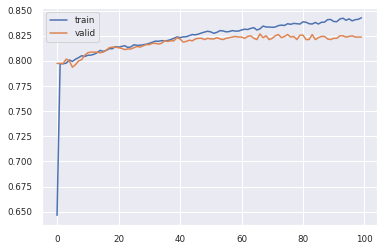

In [203]:
plt.plot(hist['binary_accuracy'])
plt.plot(hist['val_binary_accuracy'])
plt.legend(("train", "valid"), loc=0)

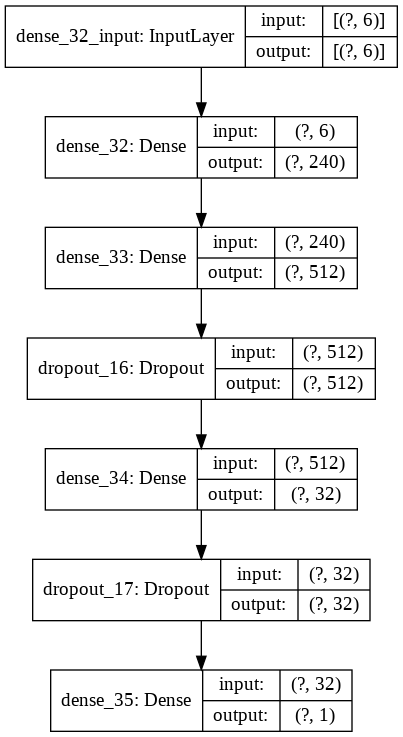

In [204]:
# Show the Model created

from keras.utils.vis_utils import plot_model

plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [205]:
results = model.evaluate(X_test, y_test.values)

63/63 [==============================] - 0s 1ms/step - loss: 0.4068 - binary_accuracy: 0.8280


In [206]:
print(model.metrics_names)
print(results)

['loss', 'binary_accuracy']
[0.40680867433547974, 0.828000009059906]


In [207]:
y_pred_cls = model.predict_classes(X_test, batch_size=num_batch, verbose=0)
print('Accuracy Model1 (Dropout): ' + str(model.evaluate(X_test, y_test.values)[1]))
print('Recall_score: ' + str(recall_score(y_test.values, y_pred_cls)))
print('Precision_score: ' + str(precision_score(y_test.values, y_pred_cls)))
print('F-score: ' + str(f1_score(y_test.values, y_pred_cls)))
confusion_matrix(y_test.values, y_pred_cls)

63/63 [==============================] - 0s 2ms/step - loss: 0.4068 - binary_accuracy: 0.8280
Accuracy Model1 (Dropout): 0.828000009059906
Recall_score: 0.2963855421686747
Precision_score: 0.7028571428571428
F-score: 0.41694915254237286


array([[1533,   52],
       [ 292,  123]])

In [208]:
# How loss moves around with each epoch

import hiplot as hip

data_vis = [{'epoch': idx,
             'loss': history.history['loss'][idx],
             'val_loss': history.history['val_loss'][idx],
             'binary_accuracy': history.history['binary_accuracy'][idx],
             'val_binary_accuracy': history.history['val_binary_accuracy'][idx],
             } for idx in range(num_epoch)]
hip.Experiment.from_iterable(data_vis).display()

<IPython.core.display.Javascript object>

In [209]:
tempResultsDf = pd.DataFrame({'Method': [model_name],
                          'Layer and Activation Function': [model_layer],
                          'Optimizer': [model_optimizer],
                          'Loss Func': [model_loss],
                          'Num of Epoc': [num_epoch],
                          'Num of Batch': [num_batch],
                          'Loss': [model.evaluate(X_test, y_test.values)[0]],
                          'Testing accuracy': [model.evaluate(X_test, y_test.values)[1]],
                          'Recall Score': [recall_score(y_test.values, y_pred_cls)],
                          'Precision Score': [precision_score(y_test.values, y_pred_cls)],
                          'F1 Score': [f1_score(y_test.values, y_pred_cls)],
                         })
resultsDf = pd.concat([resultsDf, tempResultsDf])
resultsDf = resultsDf[['Method', 'Layer and Activation Function', 'Optimizer', 'Loss Func', 'Num of Epoc','Num of Batch', 'Loss', 'Testing accuracy', 'Recall Score', 'Precision Score', 'F1 Score']]
print()
print()
resultsDf

63/63 [==============================] - 0s 3ms/step - loss: 0.4068 - binary_accuracy: 0.8280




,Method,Layer and Activation Function,Optimizer,Loss Func,Num of Epoc,Num of Batch,Loss,Testing accuracy,Recall Score,Precision Score,F1 Score
0,Model-1 (First Test),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,100,100,0.362033,0.8555,0.465060,0.742308,0.571852
0,Model-2 (Less number of Epocs),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,10,100,0.347334,0.8555,0.460241,0.746094,0.569300
0,Model-3 (Mid number of Epocs & Larger Batch),2HL 64_Relu-32_Tanh,Adam-LR_0.0001,binary_crossentropy,1000,2000,0.336002,0.8590,0.460241,0.767068,0.575301
0,Model-4 (Using the results from Hyperparameter...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,100,1000,0.430926,0.8465,0.496386,0.677632,0.573018
0,Model-5 (Using the results from Hyperparameter...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,0.334762,0.8620,0.455422,0.790795,0.577982
0,Model-6 (Trying initializer),4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,1000,7.803478,0.7670,0.445783,0.439430,0.442584
0,"Model-7 (Trying K-init RandomNormal, B-init Ra...",4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,0.339693,0.8570,0.474699,0.743396,0.579412
0,"Model-8 (Trying K-init RandomNormal, B-init Ra...",4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,13.499107,0.7705,0.438554,0.446078,0.442284
0,Model-9 (PCA & results from Hyperparameter Tun...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,50,4000,0.364693,0.8510,0.397590,0.774648,0.525478
0,"Model-10 (PCA & K-init RandomNormal, B-init Ra...",4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,0.361926,0.8520,0.402410,0.776744,0.530159


#### Insight:
PCA with 6 components was not have a good performance in this combination

In [210]:
X_ColNum = X_ColNum_bak
X_train = X_train_bak.copy()
X_test = X_test_bak.copy()

### Model-12 (PCA6 & K-init RandomNormal, B-init RandomNormal for only 1st layer)

#### Note
Try 40 Epoc & 4000 Batch

In [211]:
model_name = "Model-12 (PCA6 & K-init RandomNormal, B-init RandomNormal for only 1st layer)"
model_layer = "4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_Dropout"
model_optimizer = "Adam-LR_0.0001"
model_loss = "binary_crossentropy"

num_epoch = 150
num_batch = 4000

X_ColNum_bak = X_ColNum
X_ColNum = num_pca

X_train_bak = X_train.copy()
X_train = X_train_pca

X_test_bak = X_test.copy()
X_test = X_test_pca

In [212]:
model = Sequential()

model.add(Dense(240, kernel_initializer=initializers.RandomNormal(mean=0.0, stddev=1.0), bias_initializer=initializers.RandomNormal(mean=0.0, stddev=1.0),input_shape=(X_ColNum, ), activation='tanh'))
model.add(Dense(512, activation='relu'))
model.add(Dropout(0.0))
model.add(Dense(32, activation='relu'))
model.add(Dropout(0.0))
model.add(Dense(1, activation='sigmoid'))

sgd = optimizers.Adam(lr=0.0001)

# Use 0.5 as a threshold

tf.keras.metrics.BinaryAccuracy(
    name='binary_accuracy', dtype=None, threshold=0.5
)

model.compile(optimizer=sgd, loss='binary_crossentropy', metrics=[tf.keras.metrics.BinaryAccuracy()])

model.summary()

history = model.fit(X_train, y_train.values, batch_size=num_batch, epochs=num_epoch, verbose=1, validation_split=0.2)

Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_36 (Dense)             (None, 240)               1680      
_________________________________________________________________
dense_37 (Dense)             (None, 512)               123392    
_________________________________________________________________
dropout_18 (Dropout)         (None, 512)               0         
_________________________________________________________________
dense_38 (Dense)             (None, 32)                16416     
_________________________________________________________________
dropout_19 (Dropout)         (None, 32)                0         
_________________________________________________________________
dense_39 (Dense)             (None, 1)                 33        
Total params: 141,521
Trainable params: 141,521
Non-trainable params: 0
________________________________________________

In [213]:
history.history.keys()

dict_keys(['loss', 'binary_accuracy', 'val_loss', 'val_binary_accuracy'])

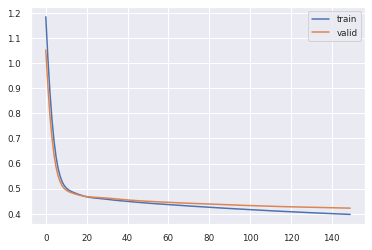

In [214]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch

plt.plot(hist['loss'])
plt.plot(hist['val_loss'])
plt.legend(("train", "valid"), loc=0)

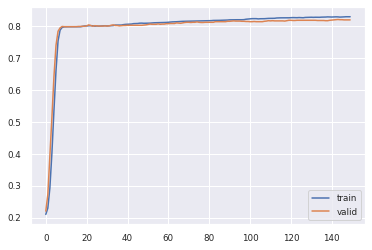

In [215]:
plt.plot(hist['binary_accuracy'])
plt.plot(hist['val_binary_accuracy'])
plt.legend(("train", "valid"), loc=0)

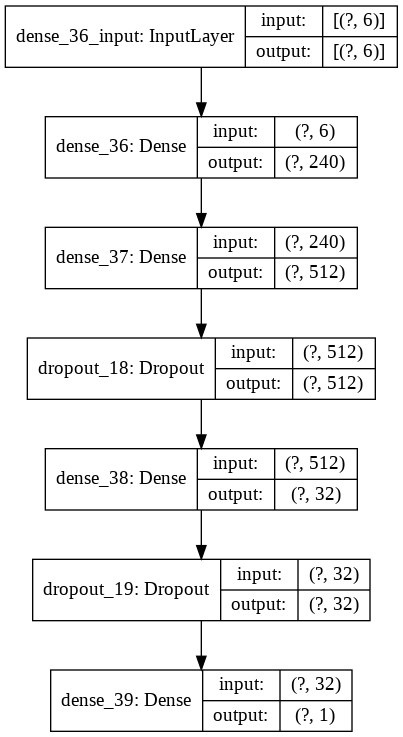

In [216]:
# Show the Model created

from keras.utils.vis_utils import plot_model

plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [217]:
results = model.evaluate(X_test, y_test.values)

63/63 [==============================] - 0s 2ms/step - loss: 0.4180 - binary_accuracy: 0.8195


In [218]:
print(model.metrics_names)
print(results)

['loss', 'binary_accuracy']
[0.417995423078537, 0.8195000290870667]


In [219]:
y_pred_cls = model.predict_classes(X_test, batch_size=100, verbose=0)
print('Accuracy Model1 (Dropout): ' + str(model.evaluate(X_test, y_test.values)[1]))
print('Recall_score: ' + str(recall_score(y_test.values, y_pred_cls)))
print('Precision_score: ' + str(precision_score(y_test.values, y_pred_cls)))
print('F-score: ' + str(f1_score(y_test.values, y_pred_cls)))
confusion_matrix(y_test.values, y_pred_cls)

63/63 [==============================] - 0s 2ms/step - loss: 0.4180 - binary_accuracy: 0.8195
Accuracy Model1 (Dropout): 0.8195000290870667
Recall_score: 0.21686746987951808
Precision_score: 0.7142857142857143
F-score: 0.33271719038817005


array([[1549,   36],
       [ 325,   90]])

In [220]:
# How loss moves around with each epoch

import hiplot as hip

data_vis = [{'epoch': idx,
             'loss': history.history['loss'][idx],
             'val_loss': history.history['val_loss'][idx],
             'binary_accuracy': history.history['binary_accuracy'][idx],
             'val_binary_accuracy': history.history['val_binary_accuracy'][idx],
             } for idx in range(num_epoch)]
hip.Experiment.from_iterable(data_vis).display()

<IPython.core.display.Javascript object>

In [221]:
tempResultsDf = pd.DataFrame({'Method': [model_name],
                          'Layer and Activation Function': [model_layer],
                          'Optimizer': [model_optimizer],
                          'Loss Func': [model_loss],
                          'Num of Epoc': [num_epoch],
                          'Num of Batch': [num_batch],
                          'Loss': [model.evaluate(X_test, y_test.values)[0]],
                          'Testing accuracy': [model.evaluate(X_test, y_test.values)[1]],
                          'Recall Score': [recall_score(y_test.values, y_pred_cls)],
                          'Precision Score': [precision_score(y_test.values, y_pred_cls)],
                          'F1 Score': [f1_score(y_test.values, y_pred_cls)],
                         })
resultsDf = pd.concat([resultsDf, tempResultsDf])
resultsDf = resultsDf[['Method', 'Layer and Activation Function', 'Optimizer', 'Loss Func', 'Num of Epoc','Num of Batch', 'Loss', 'Testing accuracy', 'Recall Score', 'Precision Score', 'F1 Score']]
print()
print()
resultsDf

63/63 [==============================] - 0s 2ms/step - loss: 0.4180 - binary_accuracy: 0.8195




,Method,Layer and Activation Function,Optimizer,Loss Func,Num of Epoc,Num of Batch,Loss,Testing accuracy,Recall Score,Precision Score,F1 Score
0,Model-1 (First Test),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,100,100,0.362033,0.8555,0.465060,0.742308,0.571852
0,Model-2 (Less number of Epocs),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,10,100,0.347334,0.8555,0.460241,0.746094,0.569300
0,Model-3 (Mid number of Epocs & Larger Batch),2HL 64_Relu-32_Tanh,Adam-LR_0.0001,binary_crossentropy,1000,2000,0.336002,0.8590,0.460241,0.767068,0.575301
0,Model-4 (Using the results from Hyperparameter...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,100,1000,0.430926,0.8465,0.496386,0.677632,0.573018
0,Model-5 (Using the results from Hyperparameter...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,0.334762,0.8620,0.455422,0.790795,0.577982
0,Model-6 (Trying initializer),4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,1000,7.803478,0.7670,0.445783,0.439430,0.442584
0,"Model-7 (Trying K-init RandomNormal, B-init Ra...",4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,0.339693,0.8570,0.474699,0.743396,0.579412
0,"Model-8 (Trying K-init RandomNormal, B-init Ra...",4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,13.499107,0.7705,0.438554,0.446078,0.442284
0,Model-9 (PCA & results from Hyperparameter Tun...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,50,4000,0.364693,0.8510,0.397590,0.774648,0.525478
0,"Model-10 (PCA & K-init RandomNormal, B-init Ra...",4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,0.361926,0.8520,0.402410,0.776744,0.530159


#### Insight:
Try initilizer with PCA 6 componets but didn't result in good performance

In [222]:
X_ColNum = X_ColNum_bak
X_train = X_train_bak.copy()
X_test = X_test_bak.copy()

### Model-13 (Try Upsampling)

#### Note
As the data is inbalanced, try upsampling.


In [223]:
from imblearn.over_sampling import SMOTE

In [224]:
print(X_train.shape)
print(X_test.shape)

(8000, 11)
(2000, 11)


In [225]:
print(type(X_train))
print(type(X_test))

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


In [226]:
print(y_train.shape)
print(y_test.shape)

(8000,)
(2000,)


In [227]:
print(type(y_train))
print(type(y_test))

<class 'pandas.core.series.Series'>
<class 'pandas.core.series.Series'>


In [228]:
print("Before UpSampling, counts of label '1': {}".format(sum(y_train==1)))
print("Before UpSampling, counts of label '0': {} \n".format(sum(y_train==0)))

Before UpSampling, counts of label '1': 1622
Before UpSampling, counts of label '0': 6378 



In [229]:
sm = SMOTE(sampling_strategy=1, k_neighbors=5, random_state=1)
X_train_res, y_train_res = sm.fit_sample(X_train, y_train.ravel())

In [230]:
print(X_train_res.shape)
print(y_train_res.shape)

(12756, 11)
(12756,)


In [231]:
print("After UpSampling, counts of label '1': {}".format(sum(y_train_res==1)))
print("After UpSampling, counts of label '0': {} \n".format(sum(y_train_res==0)))

After UpSampling, counts of label '1': 6378
After UpSampling, counts of label '0': 6378 



In [232]:
print('After UpSampling, the shape of train_X: {}'.format(X_train_res.shape))
print('After UpSampling, the shape of train_y: {} \n'.format(y_train_res.shape))

After UpSampling, the shape of train_X: (12756, 11)
After UpSampling, the shape of train_y: (12756,) 



In [233]:
type(X_train)

numpy.ndarray

In [234]:
type(y_train)

pandas.core.series.Series

In [235]:
type(y_test)

pandas.core.series.Series

In [236]:
model_name = "Model-13 (Try Upsampling)"
model_layer = "4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_Dropout"
model_optimizer = "Adam-LR_0.001"
model_loss = "binary_crossentropy"

num_epoch = 40
num_batch = 4000

X_train_bak = X_train.copy()
X_train = X_train_res

y_train_bak = y_train.copy()
y_train = y_train_res

In [237]:
print(type(X_train))
print(type(y_train))

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


In [238]:
y_train = pd.Series(y_train)

In [239]:
print(type(X_train))
print(type(y_train))

<class 'numpy.ndarray'>
<class 'pandas.core.series.Series'>


In [240]:
model = Sequential()

model.add(Dense(240, input_shape=(X_ColNum, ), activation='tanh'))
model.add(Dense(512, activation='relu'))
model.add(Dropout(0.0))
model.add(Dense(32, activation='relu'))
model.add(Dropout(0.0))
model.add(Dense(1, activation='sigmoid'))

sgd = optimizers.Adam(lr=0.001)

# Use 0.5 as a threshold

tf.keras.metrics.BinaryAccuracy(
    name='binary_accuracy', dtype=None, threshold=0.5
)

model.compile(optimizer=sgd, loss='binary_crossentropy', metrics=[tf.keras.metrics.BinaryAccuracy()])

model.summary()

history = model.fit(X_train, y_train.values, batch_size=num_batch, epochs=num_epoch, verbose=1, validation_split=0.2)

Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_40 (Dense)             (None, 240)               2880      
_________________________________________________________________
dense_41 (Dense)             (None, 512)               123392    
_________________________________________________________________
dropout_20 (Dropout)         (None, 512)               0         
_________________________________________________________________
dense_42 (Dense)             (None, 32)                16416     
_________________________________________________________________
dropout_21 (Dropout)         (None, 32)                0         
_________________________________________________________________
dense_43 (Dense)             (None, 1)                 33        
Total params: 142,721
Trainable params: 142,721
Non-trainable params: 0
_______________________________________________

In [241]:
history.history.keys()

dict_keys(['loss', 'binary_accuracy', 'val_loss', 'val_binary_accuracy'])

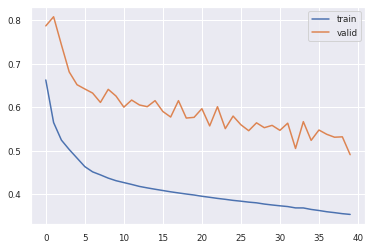

In [242]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch

plt.plot(hist['loss'])
plt.plot(hist['val_loss'])
plt.legend(("train", "valid"), loc=0)

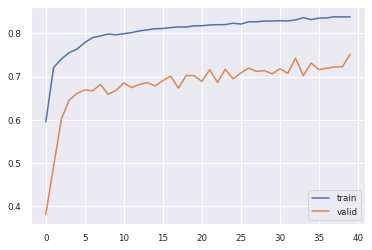

In [243]:
plt.plot(hist['binary_accuracy'])
plt.plot(hist['val_binary_accuracy'])
plt.legend(("train", "valid"), loc=0)

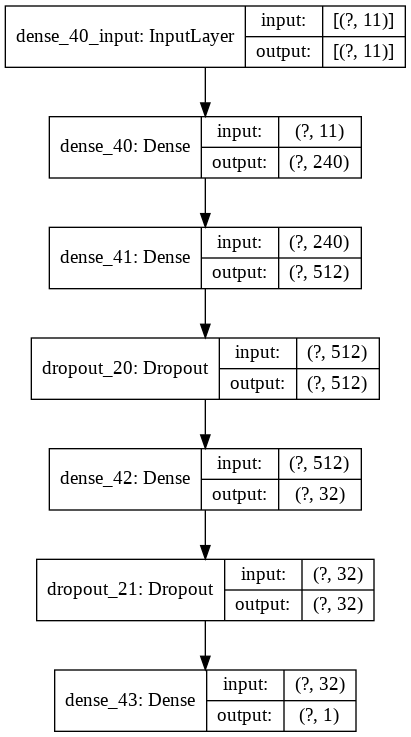

In [244]:
# Show the Model created

from keras.utils.vis_utils import plot_model

plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [245]:
results = model.evaluate(X_test, y_test.values)

63/63 [==============================] - 0s 2ms/step - loss: 0.3702 - binary_accuracy: 0.8440


In [246]:
print(model.metrics_names)
print(results)

['loss', 'binary_accuracy']
[0.37017822265625, 0.843999981880188]


In [247]:
y_pred_cls = model.predict_classes(X_test, batch_size=num_batch, verbose=0)
print('Accuracy Model1 (Dropout): ' + str(model.evaluate(X_test, y_test.values)[1]))
print('Recall_score: ' + str(recall_score(y_test.values, y_pred_cls)))
print('Precision_score: ' + str(precision_score(y_test.values, y_pred_cls)))
print('F-score: ' + str(f1_score(y_test.values, y_pred_cls)))
confusion_matrix(y_test.values, y_pred_cls)

63/63 [==============================] - 0s 2ms/step - loss: 0.3702 - binary_accuracy: 0.8440
Accuracy Model1 (Dropout): 0.843999981880188
Recall_score: 0.6674698795180722
Precision_score: 0.614190687361419
F-score: 0.6397228637413394


array([[1411,  174],
       [ 138,  277]])

In [248]:
# How loss moves around with each epoch

import hiplot as hip

data_vis = [{'epoch': idx,
             'loss': history.history['loss'][idx],
             'val_loss': history.history['val_loss'][idx],
             'binary_accuracy': history.history['binary_accuracy'][idx],
             'val_binary_accuracy': history.history['val_binary_accuracy'][idx],
             } for idx in range(num_epoch)]
hip.Experiment.from_iterable(data_vis).display()

<IPython.core.display.Javascript object>

In [249]:
tempResultsDf = pd.DataFrame({'Method': [model_name],
                          'Layer and Activation Function': [model_layer],
                          'Optimizer': [model_optimizer],
                          'Loss Func': [model_loss],
                          'Num of Epoc': [num_epoch],
                          'Num of Batch': [num_batch],
                          'Loss': [model.evaluate(X_test, y_test.values)[0]],
                          'Testing accuracy': [model.evaluate(X_test, y_test.values)[1]],
                          'Recall Score': [recall_score(y_test.values, y_pred_cls)],
                          'Precision Score': [precision_score(y_test.values, y_pred_cls)],
                          'F1 Score': [f1_score(y_test.values, y_pred_cls)],
                         })
resultsDf = pd.concat([resultsDf, tempResultsDf])
resultsDf = resultsDf[['Method', 'Layer and Activation Function', 'Optimizer', 'Loss Func', 'Num of Epoc','Num of Batch', 'Loss', 'Testing accuracy', 'Recall Score', 'Precision Score', 'F1 Score']]
print()
print()
resultsDf

63/63 [==============================] - 0s 2ms/step - loss: 0.3702 - binary_accuracy: 0.8440




,Method,Layer and Activation Function,Optimizer,Loss Func,Num of Epoc,Num of Batch,Loss,Testing accuracy,Recall Score,Precision Score,F1 Score
0,Model-1 (First Test),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,100,100,0.362033,0.8555,0.465060,0.742308,0.571852
0,Model-2 (Less number of Epocs),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,10,100,0.347334,0.8555,0.460241,0.746094,0.569300
0,Model-3 (Mid number of Epocs & Larger Batch),2HL 64_Relu-32_Tanh,Adam-LR_0.0001,binary_crossentropy,1000,2000,0.336002,0.8590,0.460241,0.767068,0.575301
0,Model-4 (Using the results from Hyperparameter...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,100,1000,0.430926,0.8465,0.496386,0.677632,0.573018
0,Model-5 (Using the results from Hyperparameter...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,0.334762,0.8620,0.455422,0.790795,0.577982
0,Model-6 (Trying initializer),4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,1000,7.803478,0.7670,0.445783,0.439430,0.442584
0,"Model-7 (Trying K-init RandomNormal, B-init Ra...",4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,0.339693,0.8570,0.474699,0.743396,0.579412
0,"Model-8 (Trying K-init RandomNormal, B-init Ra...",4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,13.499107,0.7705,0.438554,0.446078,0.442284
0,Model-9 (PCA & results from Hyperparameter Tun...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,50,4000,0.364693,0.8510,0.397590,0.774648,0.525478
0,"Model-10 (PCA & K-init RandomNormal, B-init Ra...",4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,0.361926,0.8520,0.402410,0.776744,0.530159


#### Insight:
Upsampling resulted unstable validation results. Seems like the result is showing overfitting.

In [250]:
X_train = X_train_bak.copy()
y_train = y_train_bak.copy()

In [251]:
print(X_train.shape)
print(y_train.shape)

(8000, 11)
(8000,)


### Model-14 (Try Upsampling w/ different parameter)

#### Note
As the data is inbalanced, try upsampling.


In [252]:
print(X_train.shape)
print(X_test.shape)

(8000, 11)
(2000, 11)


In [253]:
print(type(X_train))
print(type(X_test))

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


In [254]:
print(y_train.shape)
print(y_test.shape)

(8000,)
(2000,)


In [255]:
print(type(y_train))
print(type(y_test))

<class 'pandas.core.series.Series'>
<class 'pandas.core.series.Series'>


In [256]:
print("Before UpSampling, counts of label '1': {}".format(sum(y_train==1)))
print("Before UpSampling, counts of label '0': {} \n".format(sum(y_train==0)))

Before UpSampling, counts of label '1': 1622
Before UpSampling, counts of label '0': 6378 



In [257]:
sm = SMOTE(sampling_strategy=1, k_neighbors=5, random_state=1)
X_train_res, y_train_res = sm.fit_sample(X_train, y_train.ravel())

In [258]:
print(X_train_res.shape)
print(y_train_res.shape)

(12756, 11)
(12756,)


In [259]:
print("After UpSampling, counts of label '1': {}".format(sum(y_train_res==1)))
print("After UpSampling, counts of label '0': {} \n".format(sum(y_train_res==0)))

After UpSampling, counts of label '1': 6378
After UpSampling, counts of label '0': 6378 



In [260]:
print('After UpSampling, the shape of train_X: {}'.format(X_train_res.shape))
print('After UpSampling, the shape of train_y: {} \n'.format(y_train_res.shape))

After UpSampling, the shape of train_X: (12756, 11)
After UpSampling, the shape of train_y: (12756,) 



In [261]:
type(X_train)

numpy.ndarray

In [262]:
type(y_train)

pandas.core.series.Series

In [263]:
type(y_test)

pandas.core.series.Series

In [264]:
model_name = "Model-14 (Try Upsampling w/ different parameter)"
model_layer = "4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_Dropout"
model_optimizer = "Adam-LR_0.0001"
model_loss = "binary_crossentropy"

num_epoch = 100
num_batch = 4000

X_train_bak = X_train.copy()
X_train = X_train_res

y_train_bak = y_train.copy()
y_train = y_train_res

In [265]:
print(type(X_train))
print(type(y_train))

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


In [266]:
y_train = pd.Series(y_train)

In [267]:
print(type(X_train))
print(type(y_train))

<class 'numpy.ndarray'>
<class 'pandas.core.series.Series'>


In [268]:
model = Sequential()

model.add(Dense(240, input_shape=(X_ColNum, ), activation='tanh'))
model.add(Dense(512, activation='relu'))
model.add(Dropout(0.2))
model.add(Dense(32, activation='relu'))
model.add(Dropout(0.2))
model.add(Dense(1, activation='sigmoid'))

sgd = optimizers.Adam(lr=0.0001)

# Use 0.5 as a threshold

tf.keras.metrics.BinaryAccuracy(
    name='binary_accuracy', dtype=None, threshold=0.5
)

model.compile(optimizer=sgd, loss='binary_crossentropy', metrics=[tf.keras.metrics.BinaryAccuracy()])

model.summary()

history = model.fit(X_train, y_train.values, batch_size=num_batch, epochs=num_epoch, verbose=1, validation_split=0.2)

Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_44 (Dense)             (None, 240)               2880      
_________________________________________________________________
dense_45 (Dense)             (None, 512)               123392    
_________________________________________________________________
dropout_22 (Dropout)         (None, 512)               0         
_________________________________________________________________
dense_46 (Dense)             (None, 32)                16416     
_________________________________________________________________
dropout_23 (Dropout)         (None, 32)                0         
_________________________________________________________________
dense_47 (Dense)             (None, 1)                 33        
Total params: 142,721
Trainable params: 142,721
Non-trainable params: 0
_______________________________________________

In [269]:
history.history.keys()

dict_keys(['loss', 'binary_accuracy', 'val_loss', 'val_binary_accuracy'])

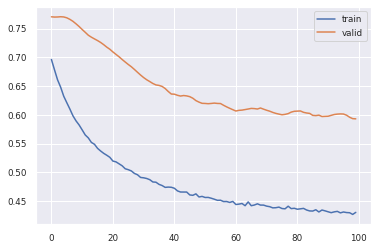

In [270]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch

plt.plot(hist['loss'])
plt.plot(hist['val_loss'])
plt.legend(("train", "valid"), loc=0)

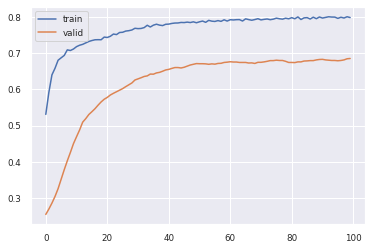

In [271]:
plt.plot(hist['binary_accuracy'])
plt.plot(hist['val_binary_accuracy'])
plt.legend(("train", "valid"), loc=0)

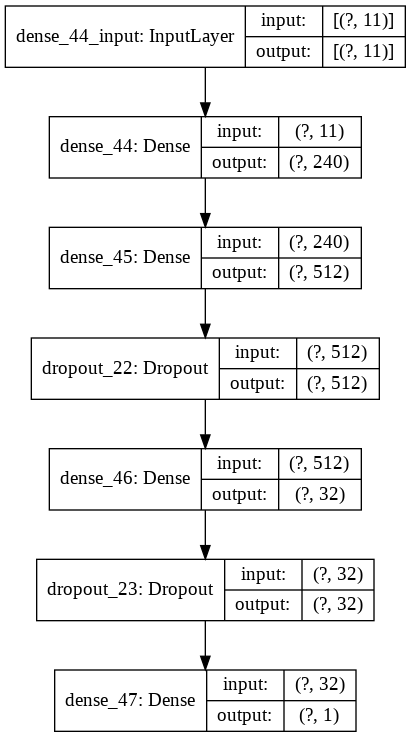

In [272]:
# Show the Model created

from keras.utils.vis_utils import plot_model

plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [273]:
results = model.evaluate(X_test, y_test.values)

63/63 [==============================] - 0s 2ms/step - loss: 0.3750 - binary_accuracy: 0.8360


In [274]:
print(model.metrics_names)
print(results)

['loss', 'binary_accuracy']
[0.37501803040504456, 0.8360000252723694]


In [275]:
y_pred_cls = model.predict_classes(X_test, batch_size=num_batch, verbose=0)
print('Accuracy Model1 (Dropout): ' + str(model.evaluate(X_test, y_test.values)[1]))
print('Recall_score: ' + str(recall_score(y_test.values, y_pred_cls)))
print('Precision_score: ' + str(precision_score(y_test.values, y_pred_cls)))
print('F-score: ' + str(f1_score(y_test.values, y_pred_cls)))
confusion_matrix(y_test.values, y_pred_cls)

63/63 [==============================] - 0s 1ms/step - loss: 0.3750 - binary_accuracy: 0.8360
Accuracy Model1 (Dropout): 0.8360000252723694
Recall_score: 0.6506024096385542
Precision_score: 0.5960264900662252
F-score: 0.6221198156682027


array([[1402,  183],
       [ 145,  270]])

In [276]:
# How loss moves around with each epoch

import hiplot as hip

data_vis = [{'epoch': idx,
             'loss': history.history['loss'][idx],
             'val_loss': history.history['val_loss'][idx],
             'binary_accuracy': history.history['binary_accuracy'][idx],
             'val_binary_accuracy': history.history['val_binary_accuracy'][idx],
             } for idx in range(num_epoch)]
hip.Experiment.from_iterable(data_vis).display()

<IPython.core.display.Javascript object>

In [277]:
tempResultsDf = pd.DataFrame({'Method': [model_name],
                          'Layer and Activation Function': [model_layer],
                          'Optimizer': [model_optimizer],
                          'Loss Func': [model_loss],
                          'Num of Epoc': [num_epoch],
                          'Num of Batch': [num_batch],
                          'Loss': [model.evaluate(X_test, y_test.values)[0]],
                          'Testing accuracy': [model.evaluate(X_test, y_test.values)[1]],
                          'Recall Score': [recall_score(y_test.values, y_pred_cls)],
                          'Precision Score': [precision_score(y_test.values, y_pred_cls)],
                          'F1 Score': [f1_score(y_test.values, y_pred_cls)],
                         })
resultsDf = pd.concat([resultsDf, tempResultsDf])
resultsDf = resultsDf[['Method', 'Layer and Activation Function', 'Optimizer', 'Loss Func', 'Num of Epoc','Num of Batch', 'Loss', 'Testing accuracy', 'Recall Score', 'Precision Score', 'F1 Score']]
print()
print()
resultsDf

63/63 [==============================] - 0s 2ms/step - loss: 0.3750 - binary_accuracy: 0.8360




,Method,Layer and Activation Function,Optimizer,Loss Func,Num of Epoc,Num of Batch,Loss,Testing accuracy,Recall Score,Precision Score,F1 Score
0,Model-1 (First Test),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,100,100,0.362033,0.8555,0.465060,0.742308,0.571852
0,Model-2 (Less number of Epocs),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,10,100,0.347334,0.8555,0.460241,0.746094,0.569300
0,Model-3 (Mid number of Epocs & Larger Batch),2HL 64_Relu-32_Tanh,Adam-LR_0.0001,binary_crossentropy,1000,2000,0.336002,0.8590,0.460241,0.767068,0.575301
0,Model-4 (Using the results from Hyperparameter...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,100,1000,0.430926,0.8465,0.496386,0.677632,0.573018
0,Model-5 (Using the results from Hyperparameter...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,0.334762,0.8620,0.455422,0.790795,0.577982
0,Model-6 (Trying initializer),4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,1000,7.803478,0.7670,0.445783,0.439430,0.442584
0,"Model-7 (Trying K-init RandomNormal, B-init Ra...",4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,0.339693,0.8570,0.474699,0.743396,0.579412
0,"Model-8 (Trying K-init RandomNormal, B-init Ra...",4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,13.499107,0.7705,0.438554,0.446078,0.442284
0,Model-9 (PCA & results from Hyperparameter Tun...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,50,4000,0.364693,0.8510,0.397590,0.774648,0.525478
0,"Model-10 (PCA & K-init RandomNormal, B-init Ra...",4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,0.361926,0.8520,0.402410,0.776744,0.530159


#### Insight:
Smaller lerarning rate improved the performance a little

In [278]:
X_train = X_train_bak.copy()
y_train = y_train_bak.copy()

In [279]:
print(X_train.shape)
print(y_train.shape)

(8000, 11)
(8000,)


### Model-15 (Try Down Sampling)

#### Note
As the data is inbalanced, try down sampling.


In [280]:
from imblearn.under_sampling import RandomUnderSampler

In [281]:
print(X_train.shape)
print(X_test.shape)

(8000, 11)
(2000, 11)


In [282]:
print(type(X_train))
print(type(X_test))

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


In [283]:
print(y_train.shape)
print(y_test.shape)

(8000,)
(2000,)


In [284]:
print(type(y_train))
print(type(y_test))

<class 'pandas.core.series.Series'>
<class 'pandas.core.series.Series'>


In [285]:
print("Before UpSampling, counts of label '1': {}".format(sum(y_train==1)))
print("Before UpSampling, counts of label '0': {} \n".format(sum(y_train==0)))

Before UpSampling, counts of label '1': 1622
Before UpSampling, counts of label '0': 6378 



In [286]:
rus = RandomUnderSampler(random_state=1)
X_train_rus, y_train_rus = rus.fit_sample(X_train, y_train.ravel())

In [287]:
print(X_train_rus.shape)
print(y_train_rus.shape)

(3244, 11)
(3244,)


In [288]:
print("After UpSampling, counts of label '1': {}".format(sum(y_train_rus==1)))
print("After UpSampling, counts of label '0': {} \n".format(sum(y_train_rus==0)))

After UpSampling, counts of label '1': 1622
After UpSampling, counts of label '0': 1622 



In [289]:
print('After UpSampling, the shape of train_X: {}'.format(X_train_rus.shape))
print('After UpSampling, the shape of train_y: {} \n'.format(y_train_rus.shape))

After UpSampling, the shape of train_X: (3244, 11)
After UpSampling, the shape of train_y: (3244,) 



In [290]:
type(X_train)

numpy.ndarray

In [291]:
type(y_train)

pandas.core.series.Series

In [292]:
type(y_test)

pandas.core.series.Series

In [293]:
model_name = "Model-15 (Try Down sampling)"
model_layer = "4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_Dropout"
model_optimizer = "Adam-LR_0.0001"
model_loss = "binary_crossentropy"

num_epoch = 40
num_batch = 4000

X_train_bak = X_train.copy()
X_train = X_train_rus

y_train_bak = y_train.copy()
y_train = y_train_rus

In [294]:
print(type(X_train))
print(type(y_train))

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


In [295]:
y_train = pd.Series(y_train)

In [296]:
print(type(X_train))
print(type(y_train))

<class 'numpy.ndarray'>
<class 'pandas.core.series.Series'>


In [297]:
model = Sequential()

model.add(Dense(240, input_shape=(X_ColNum, ), activation='tanh'))
model.add(Dense(512, activation='relu'))
model.add(Dropout(0.0))
model.add(Dense(32, activation='relu'))
model.add(Dropout(0.0))
model.add(Dense(1, activation='sigmoid'))

sgd = optimizers.Adam(lr=0.001)

# Use 0.5 as a threshold

tf.keras.metrics.BinaryAccuracy(
    name='binary_accuracy', dtype=None, threshold=0.5
)

model.compile(optimizer=sgd, loss='binary_crossentropy', metrics=[tf.keras.metrics.BinaryAccuracy()])

model.summary()

history = model.fit(X_train, y_train.values, batch_size=num_batch, epochs=num_epoch, verbose=1, validation_split=0.2)

Model: "sequential_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_48 (Dense)             (None, 240)               2880      
_________________________________________________________________
dense_49 (Dense)             (None, 512)               123392    
_________________________________________________________________
dropout_24 (Dropout)         (None, 512)               0         
_________________________________________________________________
dense_50 (Dense)             (None, 32)                16416     
_________________________________________________________________
dropout_25 (Dropout)         (None, 32)                0         
_________________________________________________________________
dense_51 (Dense)             (None, 1)                 33        
Total params: 142,721
Trainable params: 142,721
Non-trainable params: 0
_______________________________________________

In [298]:
history.history.keys()

dict_keys(['loss', 'binary_accuracy', 'val_loss', 'val_binary_accuracy'])

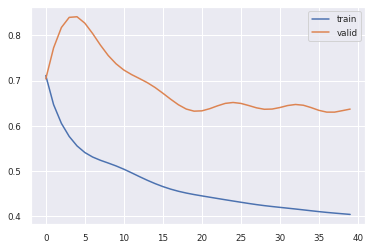

In [299]:
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch

plt.plot(hist['loss'])
plt.plot(hist['val_loss'])
plt.legend(("train", "valid"), loc=0)

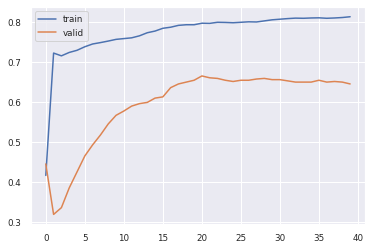

In [300]:
plt.plot(hist['binary_accuracy'])
plt.plot(hist['val_binary_accuracy'])
plt.legend(("train", "valid"), loc=0)

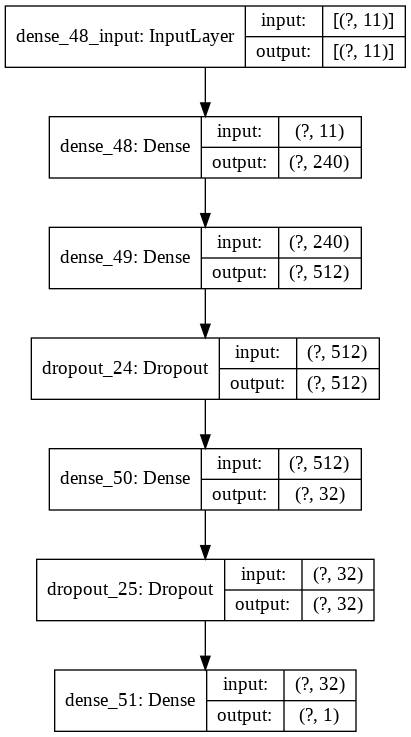

In [301]:
# Show the Model created

from keras.utils.vis_utils import plot_model

plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

In [302]:
results = model.evaluate(X_test, y_test.values)

63/63 [==============================] - 0s 2ms/step - loss: 0.3866 - binary_accuracy: 0.8335


In [303]:
print(model.metrics_names)
print(results)

['loss', 'binary_accuracy']
[0.38660678267478943, 0.8335000276565552]


In [304]:
y_pred_cls = model.predict_classes(X_test, batch_size=num_batch, verbose=0)
print('Accuracy Model1 (Dropout): ' + str(model.evaluate(X_test, y_test.values)[1]))
print('Recall_score: ' + str(recall_score(y_test.values, y_pred_cls)))
print('Precision_score: ' + str(precision_score(y_test.values, y_pred_cls)))
print('F-score: ' + str(f1_score(y_test.values, y_pred_cls)))
confusion_matrix(y_test.values, y_pred_cls)

63/63 [==============================] - 0s 2ms/step - loss: 0.3866 - binary_accuracy: 0.8335
Accuracy Model1 (Dropout): 0.8335000276565552
Recall_score: 0.655421686746988
Precision_score: 0.5887445887445888
F-score: 0.6202964652223489


array([[1395,  190],
       [ 143,  272]])

In [305]:
# How loss moves around with each epoch

import hiplot as hip

data_vis = [{'epoch': idx,
             'loss': history.history['loss'][idx],
             'val_loss': history.history['val_loss'][idx],
             'binary_accuracy': history.history['binary_accuracy'][idx],
             'val_binary_accuracy': history.history['val_binary_accuracy'][idx],
             } for idx in range(num_epoch)]
hip.Experiment.from_iterable(data_vis).display()

<IPython.core.display.Javascript object>

In [306]:
tempResultsDf = pd.DataFrame({'Method': [model_name],
                          'Layer and Activation Function': [model_layer],
                          'Optimizer': [model_optimizer],
                          'Loss Func': [model_loss],
                          'Num of Epoc': [num_epoch],
                          'Num of Batch': [num_batch],
                          'Loss': [model.evaluate(X_test, y_test.values)[0]],
                          'Testing accuracy': [model.evaluate(X_test, y_test.values)[1]],
                          'Recall Score': [recall_score(y_test.values, y_pred_cls)],
                          'Precision Score': [precision_score(y_test.values, y_pred_cls)],
                          'F1 Score': [f1_score(y_test.values, y_pred_cls)],
                         })
resultsDf = pd.concat([resultsDf, tempResultsDf])
resultsDf = resultsDf[['Method', 'Layer and Activation Function', 'Optimizer', 'Loss Func', 'Num of Epoc','Num of Batch', 'Loss', 'Testing accuracy', 'Recall Score', 'Precision Score', 'F1 Score']]
print()
print()
resultsDf

63/63 [==============================] - 0s 3ms/step - loss: 0.3866 - binary_accuracy: 0.8335




,Method,Layer and Activation Function,Optimizer,Loss Func,Num of Epoc,Num of Batch,Loss,Testing accuracy,Recall Score,Precision Score,F1 Score
0,Model-1 (First Test),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,100,100,0.362033,0.8555,0.465060,0.742308,0.571852
0,Model-2 (Less number of Epocs),2HL 64_Relu-32_Tanh,Adam-LR_0.001,binary_crossentropy,10,100,0.347334,0.8555,0.460241,0.746094,0.569300
0,Model-3 (Mid number of Epocs & Larger Batch),2HL 64_Relu-32_Tanh,Adam-LR_0.0001,binary_crossentropy,1000,2000,0.336002,0.8590,0.460241,0.767068,0.575301
0,Model-4 (Using the results from Hyperparameter...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,100,1000,0.430926,0.8465,0.496386,0.677632,0.573018
0,Model-5 (Using the results from Hyperparameter...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,0.334762,0.8620,0.455422,0.790795,0.577982
0,Model-6 (Trying initializer),4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,1000,7.803478,0.7670,0.445783,0.439430,0.442584
0,"Model-7 (Trying K-init RandomNormal, B-init Ra...",4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,0.339693,0.8570,0.474699,0.743396,0.579412
0,"Model-8 (Trying K-init RandomNormal, B-init Ra...",4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,13.499107,0.7705,0.438554,0.446078,0.442284
0,Model-9 (PCA & results from Hyperparameter Tun...,4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,50,4000,0.364693,0.8510,0.397590,0.774648,0.525478
0,"Model-10 (PCA & K-init RandomNormal, B-init Ra...",4HL 240_Tanh-512_Relu-0.0_Dropout-32_Relu-0.0_...,Adam-LR_0.001,binary_crossentropy,40,4000,0.361926,0.8520,0.402410,0.776744,0.530159


#### Insight:
The result from down sampling was not so different from the result from up sampling.

In [307]:
X_train = X_train_bak.copy()
y_train = y_train_bak.copy()

In [308]:
print(X_train.shape)
print(y_train.shape)

(8000, 11)
(8000,)


# [Conclusion]
Based on the trial, Model-5 which is using the results from Hyperparameter Tuning and Number of Epoc 40, Number of Batch 4,000 resulted to the best performance from the loss perspective.

### Github
*https://github.com/GreatLearningAIML1/gl-pgp-aiml-uta-intl-aug20-KokiTabayashi.git*